In [2]:
import sys
import pickle
from os.path import join
sys.path.append("../../src")

import pandas as pd
import numpy as np

import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgba
from matplotlib.collections import PolyCollection

from scipy.stats import spearmanr

import video_analyses
from data_processing import *
from plot_utils import *
import mne

import warnings
warnings.filterwarnings("ignore")


# FOR NATURE COMMUNICATIONS GUIDELINES
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = ['Arial']
plt.rcParams['figure.dpi'] = 300
plt.rcParams['savefig.dpi'] = 300

address_CENIR = '../../../CENIR_NEURORELAXMARKERS/'

%load_ext autoreload
%autoreload 2

In [ ]:
import pkg_resources

# List of external modules used (excluding standard library modules)
modules = ["pandas", "numpy", "seaborn", "matplotlib", "scipy", "statsmodels", "mne"]

# Create and write to requirements.txt
with open("requirements.txt", "w") as f:
    for module in modules:
        try:
            # Get the version and write it to the file
            version = pkg_resources.get_distribution(module).version
            f.write(f"{module}=={version}\n")
        except pkg_resources.DistributionNotFound:
            print(f"{module} is not installed in the environment.")


In [5]:
# Importing seaborn and matplotlib to check versions
import seaborn as sns
import matplotlib

print(sns.__version__)
print(matplotlib.__version__)
# 0.12.0
# 3.6.0

0.12.0
3.6.0


In [6]:
participants = ['00','01','02','04','05','06','07','08','09','10','11','12','13','14','15', '16', 
                '17', '20', '23', '24', '26', '28', '30','31','32','33','34']

unresponsive_IDs = ['02', '06', '10', '11', '15', '16', '20', '26', '30', '32', '34']
relaxed_IDs = ['00', '01', '04', '05', '07', '08', '09', '12', '13', '14', '17', '23', '24', '28', '31', '33']

## Code to retrieve EEG data

In [5]:
# # Define the electrode order by region
# regions = {
#     'frontal': ['Fp2', 'AF4', 'AF8', 'F8', 'F6', 'F4', 'F2','Fp1', 'AF3', 'AF7', 'F7', 'F5', 'F3', 'F1'],
#     'temporal' : ['FT8', 'FT10', 'T8', 'TP8', 'TP10','FT7', 'FT9', 'T7', 'TP7', 'TP9'],
#     'central': ['FC2', 'FC4', 'FC6', 'C6', 'C4', 'C2','FC1', 'FC3', 'FC5', 'C5', 'C3', 'C1'],
#     'parietal': ['CP2', 'CP4', 'CP6', 'P6', 'P4', 'P2','CP1', 'CP3', 'CP5', 'P5', 'P3', 'P1'],
#     'occipital': ['P8', 'PO8', 'PO4', 'O2','P7', 'PO7', 'PO3', 'O1'],
#     'midline': ['AFz', 'Fz', 'Cz', 'CPz', 'Pz', 'POz', 'Oz', 'Iz']
# }

# alpha_averages_dict = {}
# beta_averages_dict = {}
# theta_averages_dict = {}
# lgamma_averages_dict = {}
# alpha_theta_ratio_avg_dict = {}

# for i in participants:

#     # fetch the .csv files of all participants
#     sub_id = str(i).zfill(3) #fill with putting 0 in front of the number
#     alpha_file = address_CENIR+'Results_PSD/PSD_time_3D_Sub'+ sub_id +'_Alpha.csv'
#     beta_file = address_CENIR+'Results_PSD/PSD_time_3D_Sub'+ sub_id +'_Beta.csv'
#     theta_file = address_CENIR+'Results_PSD/PSD_time_3D_Sub'+ sub_id +'_Theta.csv'
#     lgamma_file = address_CENIR+'Results_PSD/PSD_time_3D_Sub'+ sub_id +'_Lgamma.csv'
    
#     # Read and preprocess the data
#     EEG_df_sub_alpha = read_and_preprocess_csv(alpha_file)
#     EEG_df_sub_beta = read_and_preprocess_csv(beta_file)
#     EEG_df_sub_theta = read_and_preprocess_csv(theta_file)
#     EEG_df_sub_lgamma = read_and_preprocess_csv(lgamma_file)

#     # Calculate total power
#     EEG_df_sub_total_power = calculate_total_power(EEG_df_sub_alpha, EEG_df_sub_beta, EEG_df_sub_theta, EEG_df_sub_lgamma)
    
#     # Calculate relative power for each band
#     EEG_df_sub_alpha_relative_power = calculate_relative_power(EEG_df_sub_alpha, EEG_df_sub_total_power)
#     EEG_df_sub_beta_relative_power = calculate_relative_power(EEG_df_sub_beta, EEG_df_sub_total_power)
#     EEG_df_sub_theta_relative_power = calculate_relative_power(EEG_df_sub_theta, EEG_df_sub_total_power)
#     EEG_df_sub_lgamma_relative_power = calculate_relative_power(EEG_df_sub_lgamma, EEG_df_sub_total_power)

#     # Calculate alpha / theta ratio
#     EEG_df_sub_alpha_theta_ratio = calculate_alpha_theta_ratio(EEG_df_sub_alpha_relative_power, EEG_df_sub_theta_relative_power)

#     # Calculate averages by region
#     alpha_averages_df = calculate_averages_by_region(EEG_df_sub_alpha_relative_power, regions, bandname='alpha')
#     beta_averages_df = calculate_averages_by_region(EEG_df_sub_beta_relative_power, regions, bandname='beta')
#     theta_averages_df = calculate_averages_by_region(EEG_df_sub_theta_relative_power, regions, bandname='theta')
#     lgamma_averages_df = calculate_averages_by_region(EEG_df_sub_lgamma_relative_power, regions, bandname='lgamma')
#     alpha_theta_ratio_avg_df = calculate_averages_by_region(EEG_df_sub_alpha_theta_ratio, regions, bandname='alpha_theta_ratio')

#     # Remove leading zeros from sub_id
#     sub_id = str(i).zfill(2)

#     # create alpha, beta, theta, lgamma, alpha theta ratio dictionaries with sub_id as key and the averages_df as value
#     alpha_averages_dict[sub_id] = alpha_averages_df
#     beta_averages_dict[sub_id] = beta_averages_df
#     theta_averages_dict[sub_id] = theta_averages_df
#     lgamma_averages_dict[sub_id] = lgamma_averages_df
#     alpha_theta_ratio_avg_dict[sub_id] = alpha_theta_ratio_avg_df

_________________________

### IMPORT EEG DATA (DIRECTLY FROM PICKLE)

In [7]:
files = [
    ('alpha_averages_dict_cleaned.pickle', 'alpha_averages'),
    ('beta_averages_dict_cleaned.pickle', 'beta_averages'),
    ('alpha_averages_2D_dict_cleaned.pickle', 'alpha_averages_2D'),
    ('beta_averages_2D_dict_cleaned.pickle', 'beta_averages_2D')
]

for filename, variable_name in files:
    file_path = join('..', 'data', filename) 
    with open(file_path, 'rb') as handle:
        data_dict = pickle.load(handle)
        globals()[variable_name] = pd.concat(data_dict.values())

beta_averages_2D.head()

,frontal_beta,temporal_beta,central_beta,parietal_beta,occipital_beta,midline_beta,Time,ID
1,0.278098,0.299352,0.309159,0.297690,0.283117,0.289844,1,00
2,0.285144,0.275057,0.293947,0.280718,0.275493,0.277542,2,00
3,0.267578,0.278197,0.290168,0.278361,0.272991,0.263316,3,00
4,0.286424,0.286572,0.295433,0.287110,0.277675,0.277370,4,00
5,0.284382,0.287652,0.294483,0.291062,0.287835,0.285692,5,00


### IMPORT ECG DATA

In [8]:
LF_3D_normalized = pd.read_csv(join('..', 'Data', 'LF_3D_normalized.csv'))
LF_2D_normalized = pd.read_csv(join('..', 'Data', 'LF_2D_normalized.csv'))
HF_3D_normalized = pd.read_csv(join('..', 'Data', 'HF_3D_normalized.csv'))
HF_2D_normalized = pd.read_csv(join('..', 'Data', 'HF_2D_normalized.csv'))
Fratio_3D_normalized = pd.read_csv(join('..', 'Data', 'Fratio_3D_normalized.csv'))
Fratio_2D_normalized = pd.read_csv(join('..', 'Data', 'Fratio_2D_normalized.csv'))

LF_3D_normalized.head()

,Unnamed: 0,LF_avg_00,LF_avg_01,LF_avg_02,LF_avg_04,LF_avg_05,LF_avg_06,LF_avg_07,LF_avg_08,LF_avg_09,...,LF_avg_30,LF_avg_31,LF_avg_32,LF_avg_33,LF_avg_34,Avg,Std,time,Std_smooth,Avg_smooth
0,0,0.120580,0.314118,0.282461,0.112915,0.223188,0.167877,0.247872,0.244886,0.465616,...,0.113256,0.019856,0.201690,0.035317,0.142828,0.220174,0.135385,60,0.135385,0.220174
1,1,0.274607,0.340863,0.444117,0.237199,0.436539,0.209137,0.199086,0.432089,0.938753,...,0.089333,0.264370,0.566033,0.054771,0.105284,0.305209,0.198026,65,0.166705,0.262692
2,2,0.380997,0.438966,0.237398,0.434605,0.305502,0.215840,0.244428,0.381090,0.965082,...,0.099743,0.310257,0.605865,0.066671,0.156149,0.328211,0.199842,70,0.177751,0.284532
3,3,0.644636,0.429997,0.252595,0.485999,0.312102,0.205922,0.531929,0.352811,0.807983,...,0.110339,0.372794,0.584428,0.056654,0.212541,0.357051,0.193929,75,0.181795,0.302661
4,4,0.504642,0.423171,0.355214,0.527290,0.745225,0.218669,0.588877,0.416779,0.887344,...,0.138587,0.386724,0.629668,0.060399,0.304992,0.401636,0.222675,80,0.189971,0.322456


### IMPORT STAIY SCORES

In [10]:
STAIY = pd.read_csv(join('..', 'Data', 'STAIY-SCORES.csv'), sep=';') #sep= ',' plutôt ? ça bugait avant
STAIY['order'] = STAIY['order'].astype(str)
#STAIY['group'] = STAIY['group'].replace({0:1, 1:0}) #quand j'avais inversé les 0 et les 1 dans csv, c'était pour inverser automatiquement, mais maintenant c'est corrigé normalement
STAIY.head()

,Participant,score,order,group
0,0,35,0,0
1,1,31,0,0
2,2,34,0,1
3,4,28,0,0
4,5,37,0,0


### PROCESS EEG DATA (VIOLIN PLOTS, regions comparison)

In [11]:
melted_data_EEG_alpha_regions_POST, melted_data_EEG_beta_regions_POST = calculate_average_by_ID_all(alpha_averages, 
                                                                    alpha_averages_2D, beta_averages, beta_averages_2D, 'after', relaxed_IDs)
melted_data_EEG_beta_regions_POST.head()

,ID,condition,group,variable,value
0,0,0,0,frontal_beta,0.287453
1,1,0,0,frontal_beta,0.290574
2,2,0,1,frontal_beta,0.278200
3,4,0,0,frontal_beta,0.297534
4,5,0,0,frontal_beta,0.304855


# Et la normalization n'avait pas été faire en enlevant le breathing donc les données ne sont pas 100% correctes (tu me dis si c'est pas très clair?) donc on corrigerait ou enlèvera cette partie

### PROCESS ECG DATA (TEMPORAL PLOTS)

In [12]:
data_types = ['LF', 'HF', 'Fratio']

new_melted_ECG_POST = pd.concat([
    calculate_average_by_ID_all_ECG(globals()[f"{data_type}_3D_normalized"].copy(),globals()[f"{data_type}_2D_normalized"].copy()) 
    for data_type in data_types
], ignore_index=True)

new_melted_ECG_POST['group'] = new_melted_ECG_POST['ID'].apply(lambda x: 0 if f'{x:02}' in relaxed_IDs 
                                                               else (1 if f'{x:02}' in unresponsive_IDs else None))
new_melted_ECG_POST.head()

,ID,condition,variable,value,group
0,0,0,LF_avg,0.603514,0
1,1,0,LF_avg,1.505677,0
2,2,0,LF_avg,0.453829,1
3,4,0,LF_avg,-0.280156,0
4,5,0,LF_avg,-0.353494,0


Combine EEG data (midline alpha and beta) with the 3 ECG metrics (LF, HF, Fratio)

In [13]:
new_melted_data_POST = pd.concat([
    new_melted_ECG_POST,
    melted_data_EEG_beta_regions_POST[melted_data_EEG_beta_regions_POST['variable'] == 'midline_beta'],
    melted_data_EEG_alpha_regions_POST[melted_data_EEG_alpha_regions_POST['variable'] == 'midline_alpha']
]).reset_index(drop=True)

## Figure 1. Condition effects on STAI-Y1 ratings, neural and cardiac correlates.

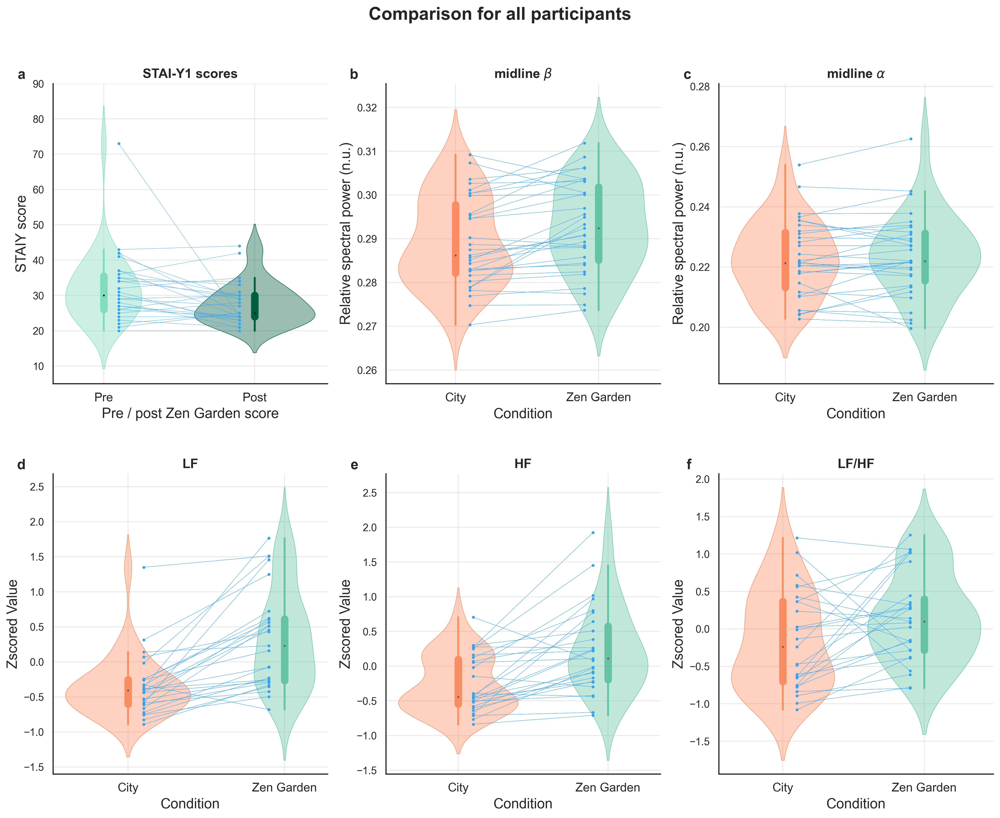

In [13]:
violin_plots_metrics_and_staiy(new_melted_data_POST, STAIY, None, 'all', 0)
# violin_plots_metrics_and_staiy(new_melted_data_POST, STAIY, 0, 'responsive', 0)
# violin_plots_metrics_and_staiy(new_melted_data_POST, STAIY, 1, 'unresponsive', 0)

## Figure 2. ECG HF spectral component differences across conditions in all participants and each subgroup.

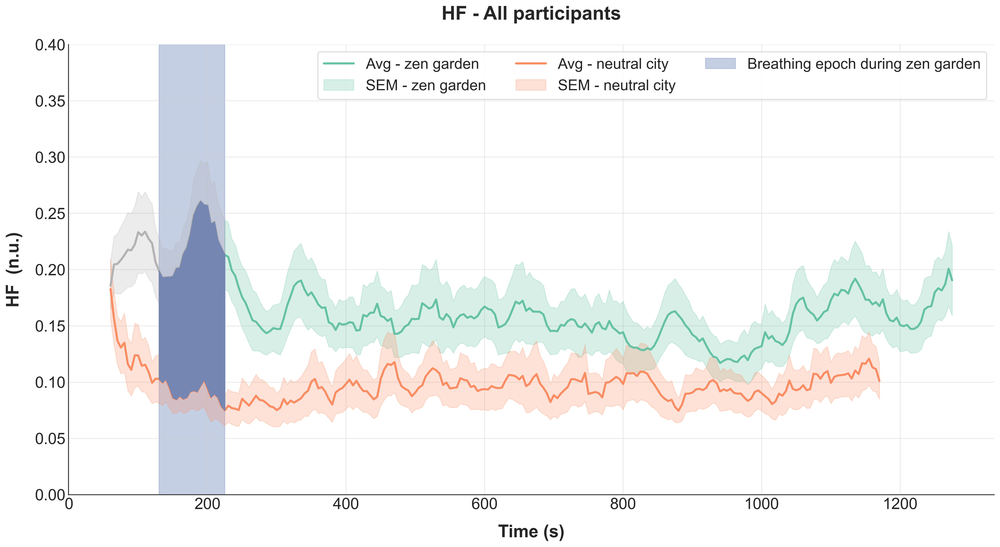

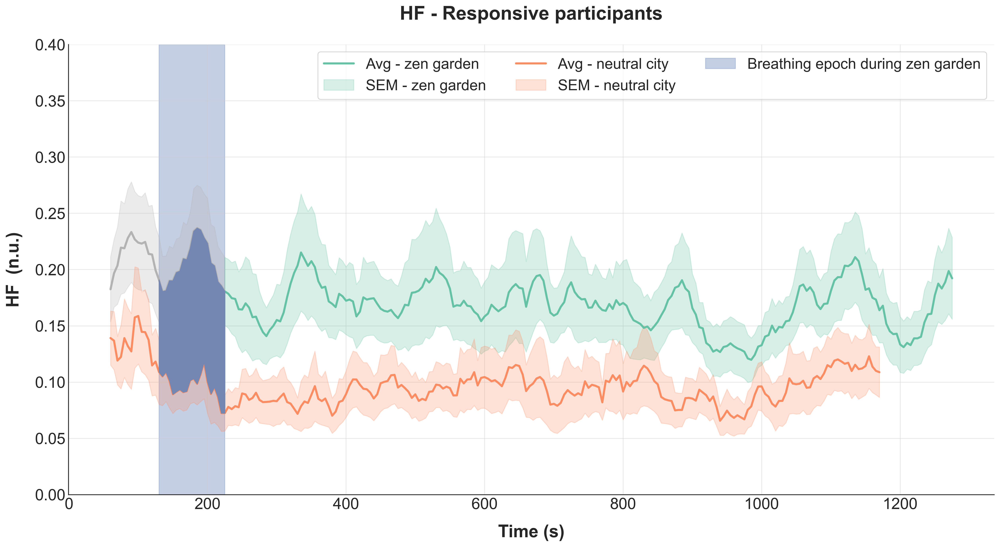

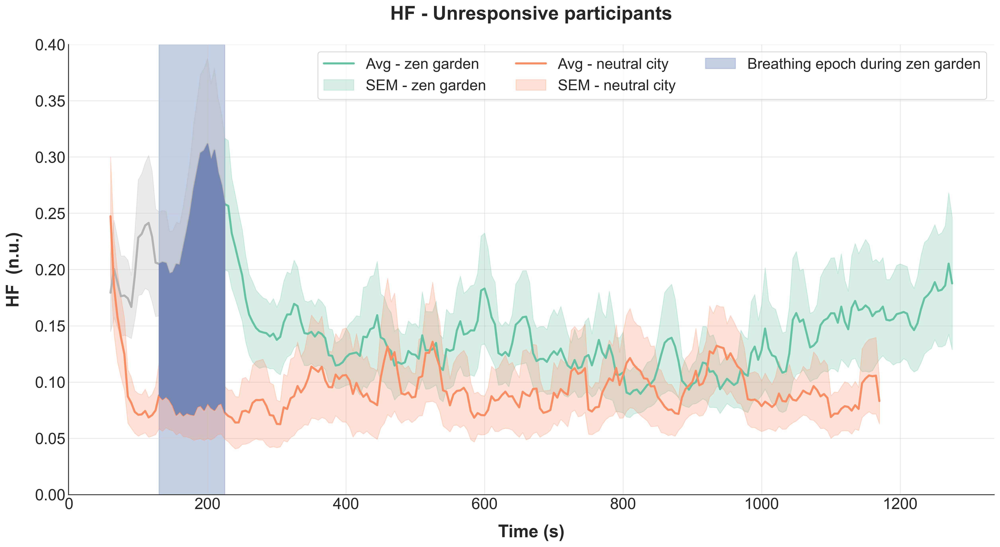

In [14]:
smoothness = 5
subgroups = [unresponsive_IDs, relaxed_IDs]
HF_unresponsive_3D, HF_unresponsive_2D, HF_relaxed_3D, HF_relaxed_2D = divide_ECG_into_groups(globals()[f"{'HF'}_3D_normalized"], globals()[f"{'HF'}_2D_normalized"], subgroups, 'HF')

temporal_plot_comparison(HF_3D_normalized, HF_2D_normalized, region='HF', band='', type='ECG', participants='All',highlight_epoch_start= 14, highlight_epoch_end=33, smoothness=5, leg_pos='upper right', n=27)
temporal_plot_comparison(HF_relaxed_3D, HF_relaxed_2D, region='HF', band='', type='ECG', participants='Responsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=16)
temporal_plot_comparison(HF_unresponsive_3D, HF_unresponsive_2D, region='HF', band='', type='ECG', participants='Unresponsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=11)

## Figure 3. ECG LF/HF ratio differences across conditions in all participants and each subgroup.

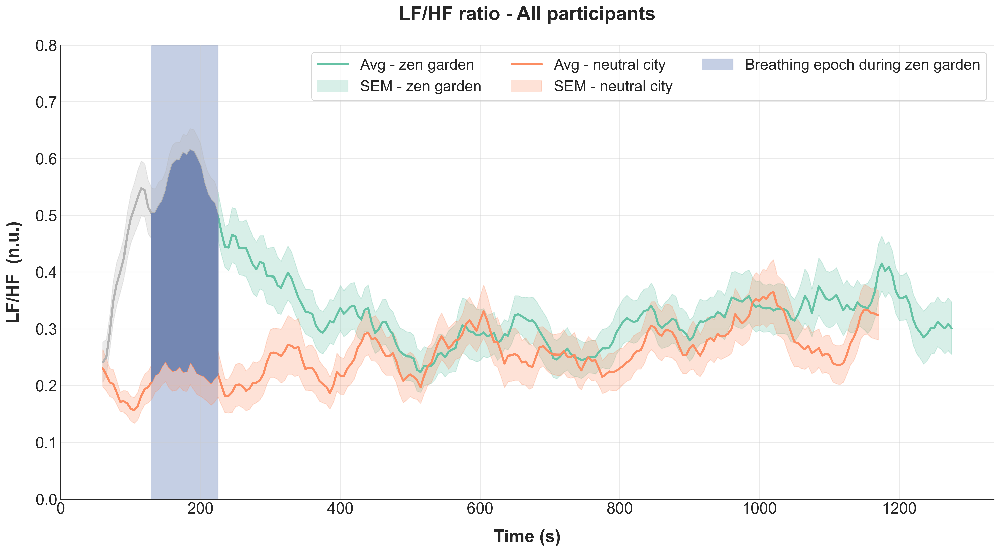

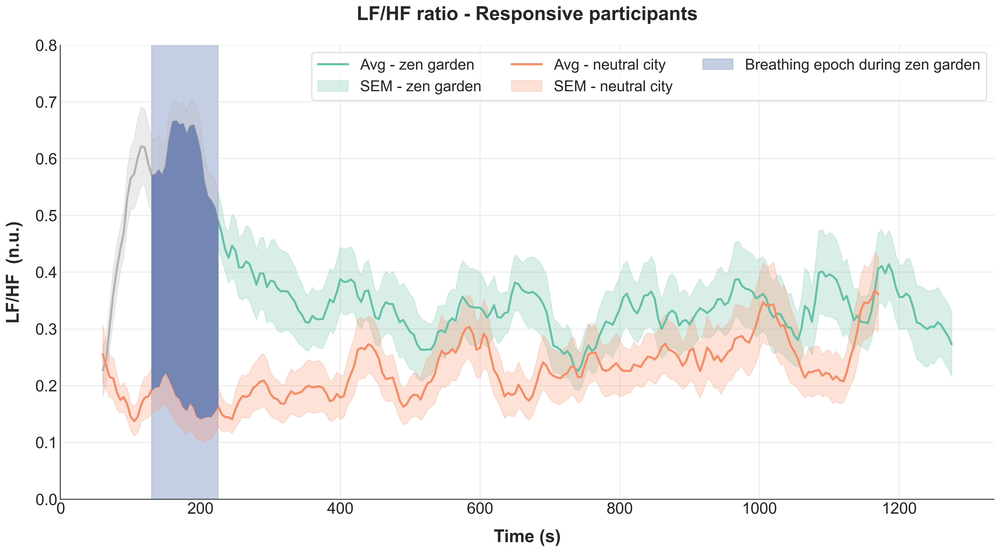

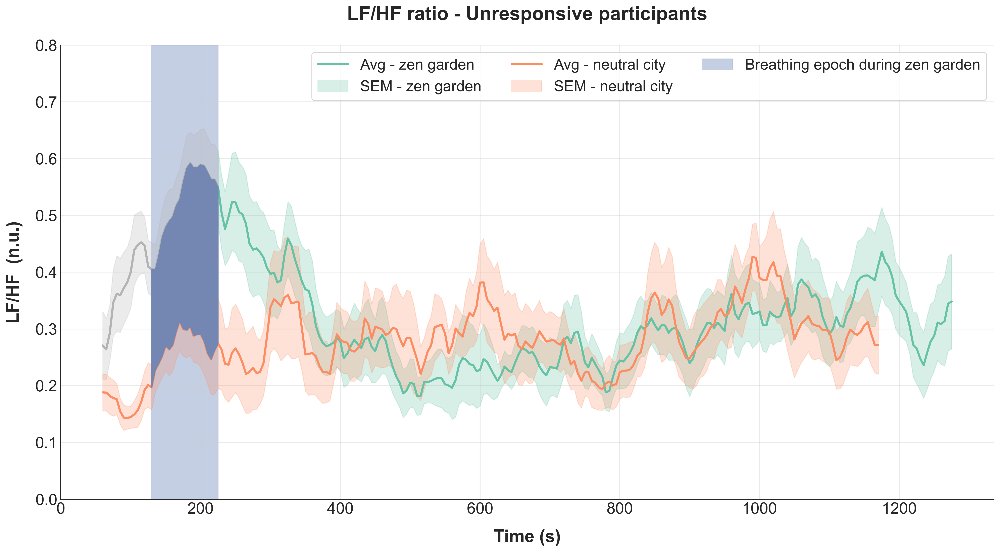

In [15]:
smoothness = 2
subgroups = [unresponsive_IDs, relaxed_IDs]
Fratio_unresponsive_3D, Fratio_unresponsive_2D, Fratio_relaxed_3D, Fratio_relaxed_2D = divide_ECG_into_groups(globals()[f"{'Fratio'}_3D_normalized"], globals()[f"{'Fratio'}_2D_normalized"], subgroups, 'Fratio')

temporal_plot_comparison(Fratio_3D_normalized, Fratio_2D_normalized, region='LF/HF', band='', type='ECG', participants='All', highlight_epoch_start= 14, highlight_epoch_end=33, smoothness=2, leg_pos='upper right', n=27)
temporal_plot_comparison(Fratio_relaxed_3D, Fratio_relaxed_2D, region='LF/HF', band='', type='ECG', participants='Responsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=16)
temporal_plot_comparison(Fratio_unresponsive_3D, Fratio_unresponsive_2D, region='LF/HF', band='', type='ECG', participants='Unresponsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=11)

## Figure 4. EEG beta band relative spectral power response in each subgroup.

To display the same temporal analysis but for the alpha band instead of beta, please decomment the line below in the "for loop"

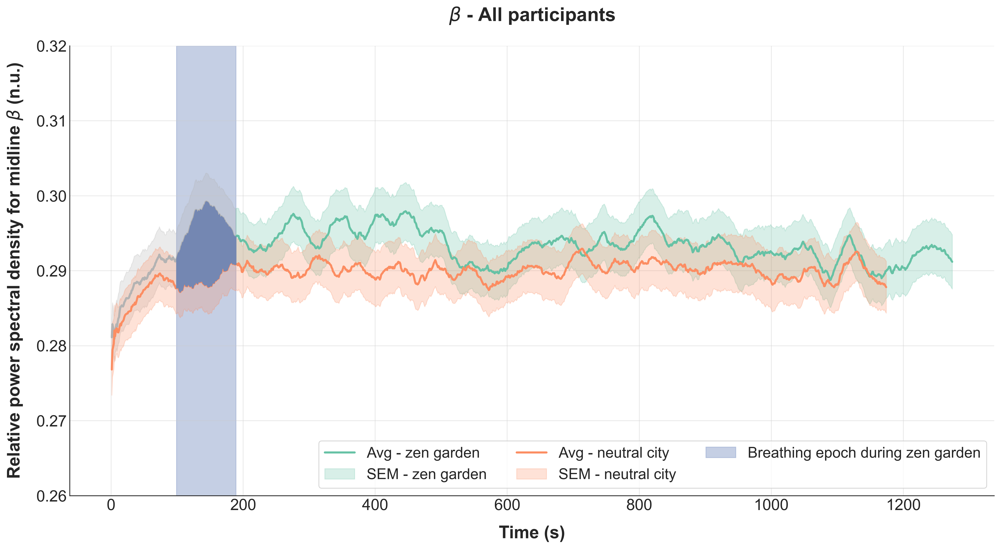

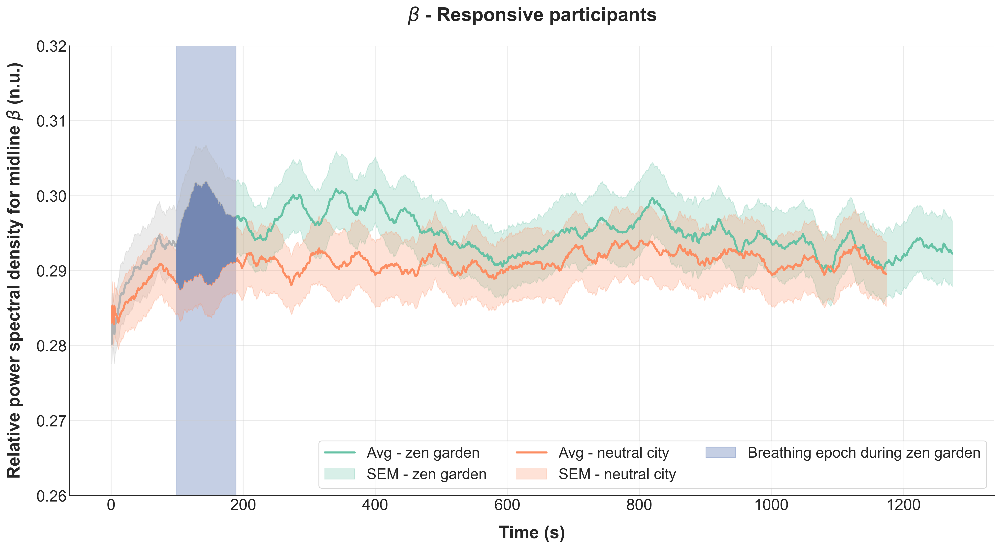

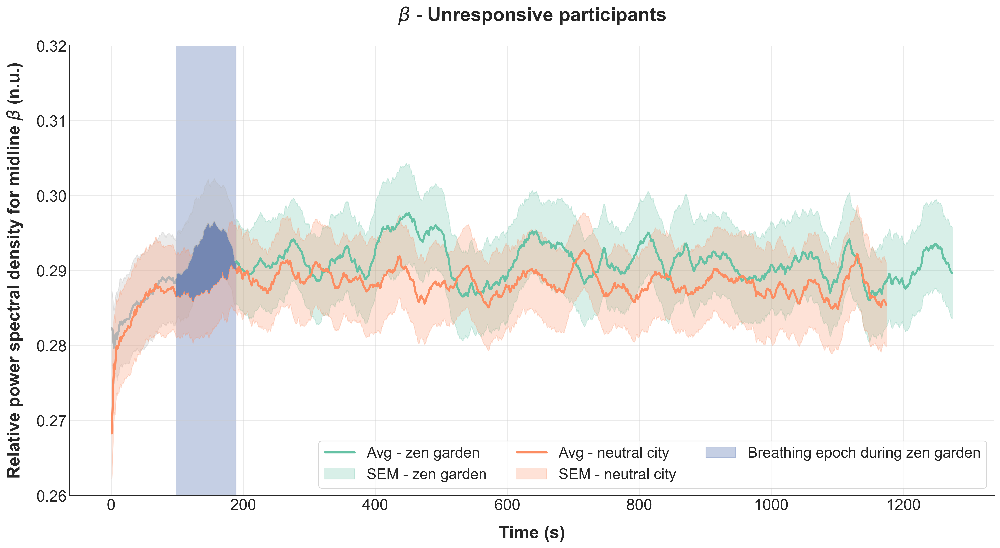

In [16]:
participant_groups = [
    {'group': participants, 'label': 'All', 'n': 27},
    {'group': relaxed_IDs, 'label': 'Responsive','n':16},
    {'group': unresponsive_IDs, 'label': 'Unresponsive', 'n': 11}
]

for group_info in participant_groups:
    
    group, label, number = group_info['group'], group_info['label'], group_info['n']

    # Computes the average across participants of same group (all, resp, unresp)
    regions_alpha, regions_beta, regions_2D_alpha, regions_2D_beta = process_EEG_by_group(alpha_averages, beta_averages, alpha_averages_2D, beta_averages_2D, group)

    # BETA BAND
    temporal_plot_comparison(regions_beta.copy(), regions_2D_beta.copy(), region='midline', band='beta', type='EEG', participants=label, highlight_epoch_start=98, highlight_epoch_end=188, smoothness=30, leg_pos='lower right', n=number)

    # ALPHA BAND
    # temporal_plot_comparison(regions_alpha.copy(), regions_2D_alpha.copy(), region='midline', band='alpha', type='EEG', participants=label, highlight_epoch_start=98, highlight_epoch_end=188, smoothness=30, leg_pos='lower right', n=number)


## Figure 5. Brain-to-heart coupling coefficients across conditions in responsive and unresponsive groups.


--------

# ADDITIONAL MATERIALS

## Supplemental Figure. 1. STAI-Y1 scores of each group.

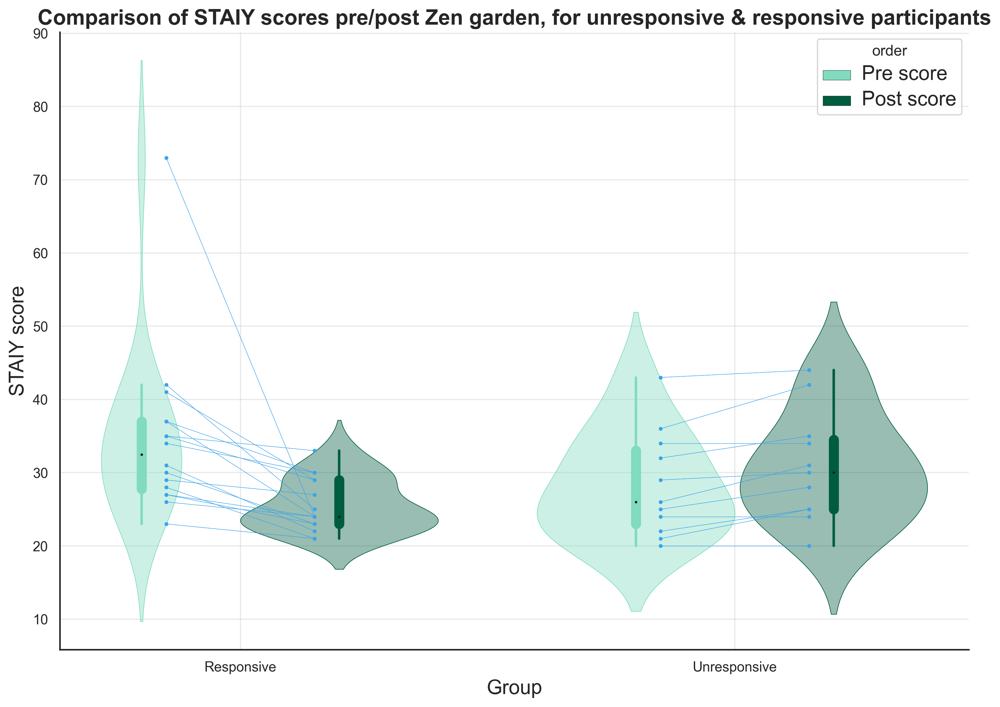

In [21]:
violin_plots_staiy(STAIY)

## Supplemental Figure. 2. Baseline STAI-Y1 scores of each group.

In [ ]:
# plot_baseline_staiy(df, group=None, subtitle=None)

## Supplemental Figure. Condition effects on beta neural correlates for each region (responsive / unresponsive)

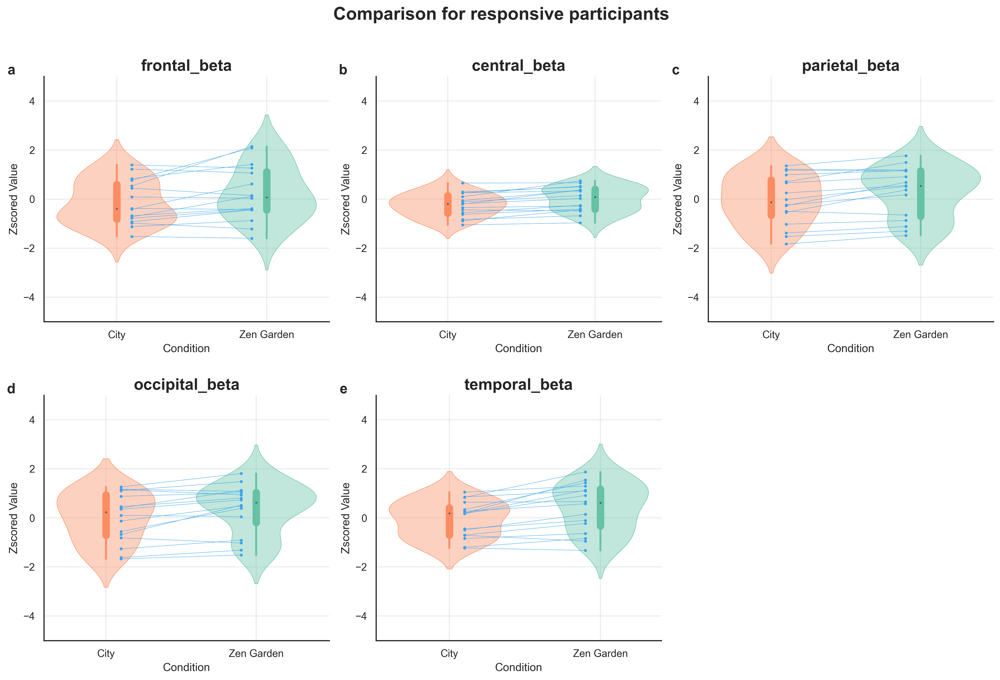

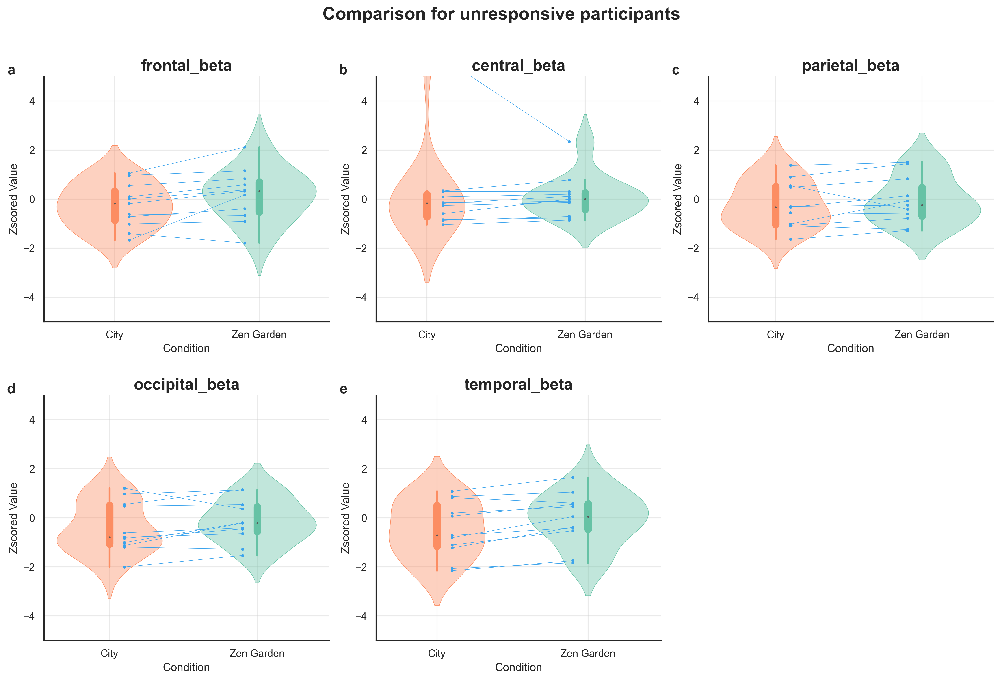

In [22]:
melted_data_beta = pd.read_csv("../Data/melted_data_EEG_beta_new.csv") # before wavelet and normalisation without breathing

violin_plots_EEG_regions(melted_data_beta, 0, 'responsive','beta')
violin_plots_EEG_regions(melted_data_beta, 1, 'unresponsive','beta')

## Supplemental Figure. Condition effects on alpha neural correlates for each region (responsive / unresponsive)

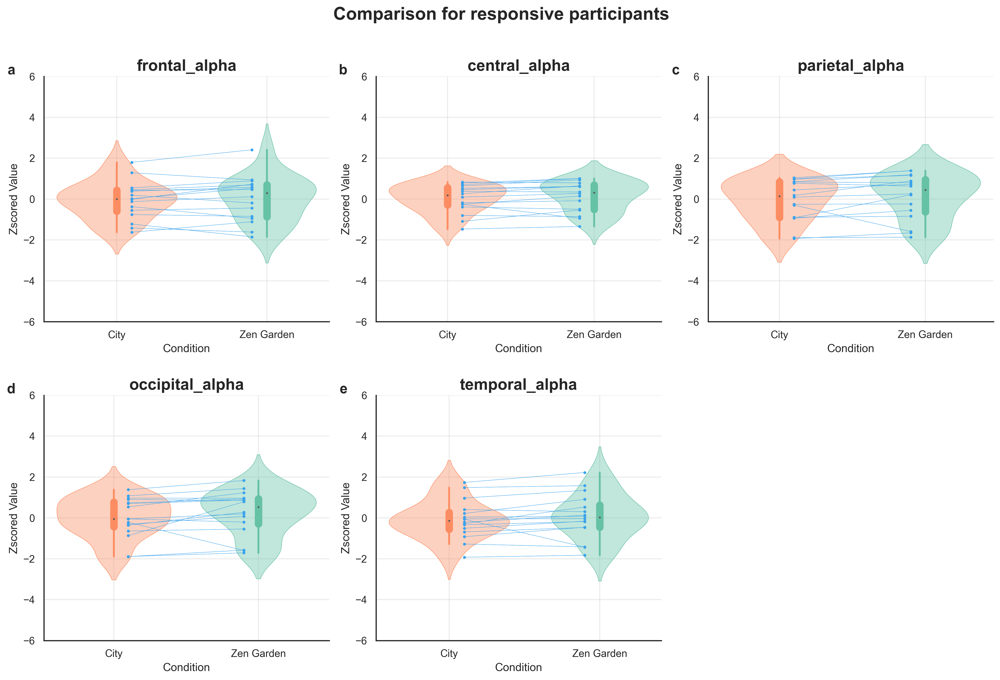

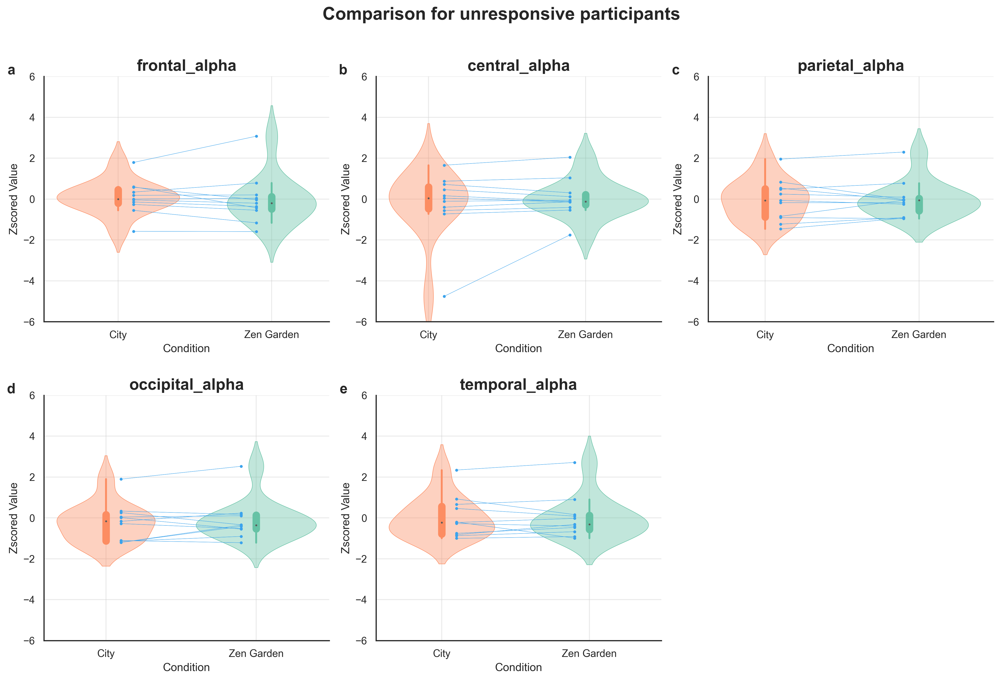

In [23]:
melted_data_alpha = pd.read_csv(join('..', 'Data', 'melted_data_EEG_alpha_new.csv')) # RECENT VERSION
violin_plots_EEG_regions(melted_data_alpha, 0, 'responsive')
violin_plots_EEG_regions(melted_data_alpha, 1, 'unresponsive')

## Supplemental Figure. ECG LF spectral component differences across conditions in each subgroup.

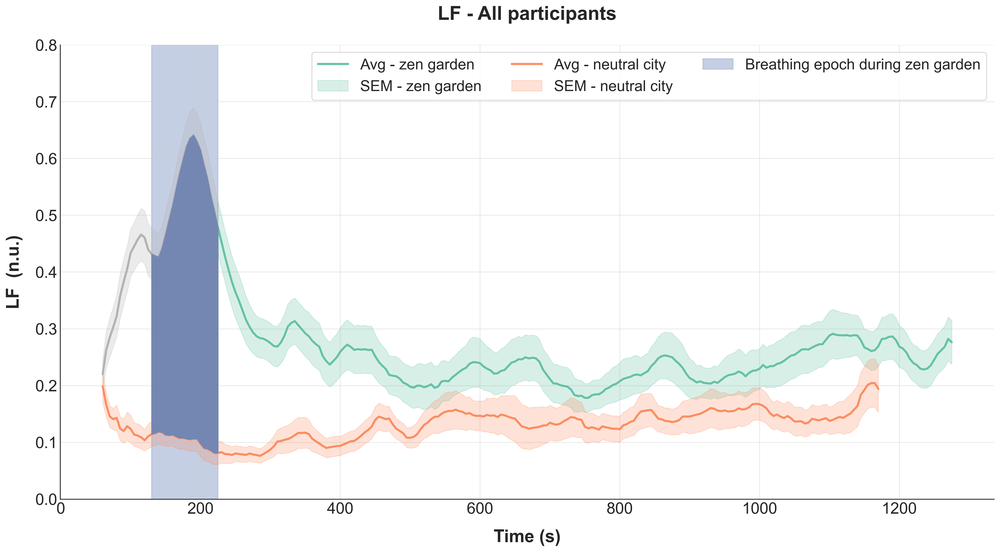

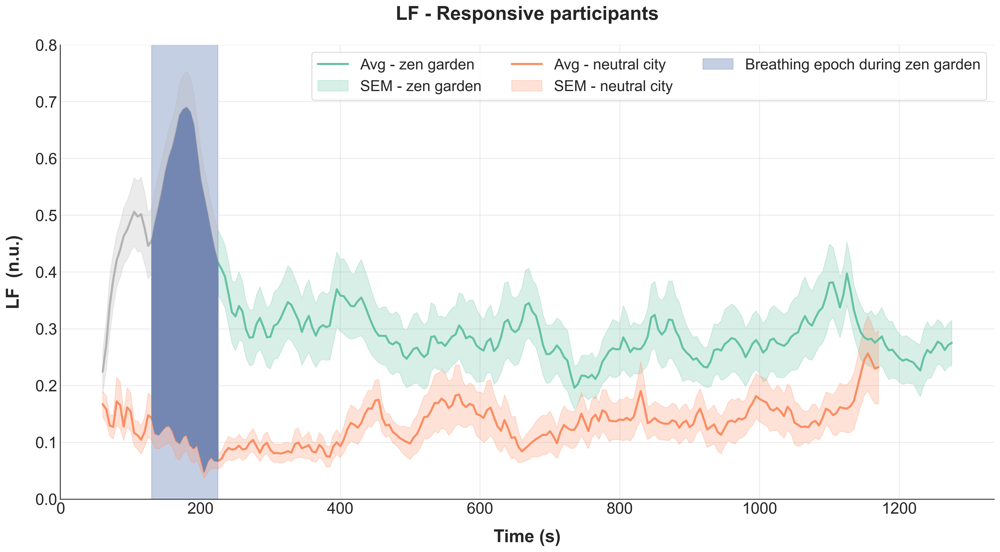

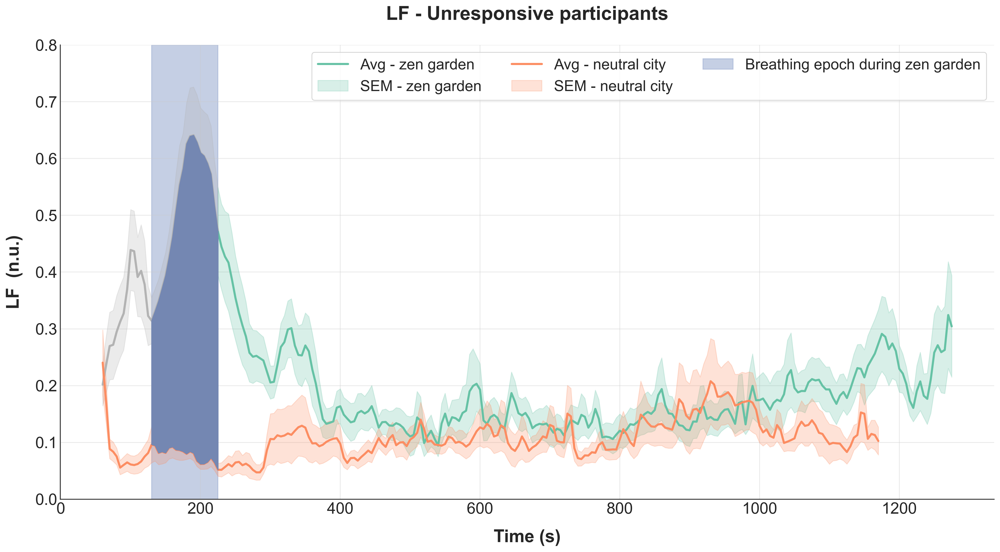

In [24]:
smoothness = 2
subgroups = [unresponsive_IDs, relaxed_IDs]
LF_unresponsive_3D, LF_unresponsive_2D, LF_relaxed_3D, LF_relaxed_2D = divide_ECG_into_groups(globals()[f"{'LF'}_3D_normalized"], globals()[f"{'LF'}_2D_normalized"], subgroups, 'LF')

temporal_plot_comparison(LF_3D_normalized, LF_2D_normalized, region='LF', band='', type='ECG', participants='All',highlight_epoch_start= 14, highlight_epoch_end=33, smoothness=5, leg_pos='upper right', n=27)
temporal_plot_comparison(LF_relaxed_3D, LF_relaxed_2D, region='LF', band='', type='ECG', participants='Responsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=16)
temporal_plot_comparison(LF_unresponsive_3D, LF_unresponsive_2D, region='LF', band='', type='ECG', participants='Unresponsive', highlight_epoch_start=14, highlight_epoch_end=33, smoothness=smoothness, leg_pos='upper right', n=11)

## TOPOGRAPHIC MAPS

In [25]:
# df_alphas_all = means_by_region(melted_data_alpha, group_option='all')
# df_alphas_all.to_csv(address_output+'/means_alpha_regions_all.csv', index=False)

df_alpha_groups = means_by_region(melted_data_alpha, group_option='groups')
# df_alpha_groups.to_csv('means_alpha_regions_groups.csv', index=False)
df_alpha_groups.head()

,condition,variable,group,value
0,0,central_alpha,0,0.131240
1,0,frontal_alpha,0,0.020820
2,0,occipital_alpha,0,0.238575
3,0,parietal_alpha,0,0.115817
4,0,temporal_alpha,0,0.069905


In [26]:
# df_betas_all = means_by_region(melted_data_beta, group_option='all')
# df_betas_all.to_csv('means_beta_regions_all.csv', index=False)

df_beta_groups = means_by_region(melted_data_beta, group_option='groups')
#df_beta_groups.to_csv('means_beta_regions_groups.csv', index=False)
df_beta_groups.head()

,condition,variable,group,value
0,0,central_beta,0,0.005735
1,0,frontal_beta,0,0.217092
2,0,occipital_beta,0,0.354335
3,0,parietal_beta,0,0.281928
4,0,temporal_beta,0,0.412516


In [27]:
melted_data_new = pd.read_csv(join('..', 'Data', 'melted_data_new.csv'))
melted_data_new['condition'] = melted_data_new['condition'].apply(lambda x: 1 if x == 0 else 0)
melted_data_new['group'] = melted_data_new['group'].apply(lambda x: 1 if x == 0 else 0)
melted_data_new.head()

,ID,condition,group,variable,value
0,0,1,0,LF_avg,-1.000042
1,0,0,0,LF_avg,0.788081
2,1,1,0,LF_avg,-0.367402
3,1,0,0,LF_avg,1.989455
4,2,1,1,LF_avg,-0.852645


In [28]:
data_means = means_by_region(melted_data_new, group_option='groups')
data_means.head()

,condition,variable,group,value
0,0,Fratio_avg,0,0.498820
1,0,HF_avg,0,0.612351
2,0,LF_avg,0,0.833168
3,0,midline_alpha,0,0.005276
4,0,midline_beta,0,0.440985


In [29]:
regions = {
    'frontal': ['Fp2', 'AF4', 'AF8', 'F8', 'F6', 'F4', 'F2', 'Fp1', 'AF3', 'AF7', 'F7', 'F5', 'F3', 'F1'],
    'temporal': ['FT8', 'FT10', 'T8', 'TP8', 'TP10', 'FT7', 'FT9', 'T7', 'TP7', 'TP9'],
    'central': ['FC2', 'FC4', 'FC6', 'C6', 'C4', 'C2', 'FC1', 'FC3', 'FC5', 'C5', 'C3', 'C1'],
    'parietal': ['CP2', 'CP4', 'CP6', 'P6', 'P4', 'P2', 'CP1', 'CP3', 'CP5', 'P5', 'P3', 'P1'],
    'occipital': ['P8', 'PO8', 'PO4', 'O2', 'P7', 'PO7', 'PO3', 'O1'],
    'midline': ['AFz', 'Fz', 'Cz', 'CPz', 'Pz', 'POz', 'Oz', 'Iz']
}

Responsive beta

In [30]:
beta_resp = extract_contrast_values(df_beta_groups, 0, 'beta')
beta_resp

{'central_value': 0.24140299407723326,
 'frontal_value': 0.3589475025909245,
 'occipital_value': 0.34318015387864687,
 'parietal_value': 0.34429739516588964,
 'temporal_value': 0.47930915853725986}

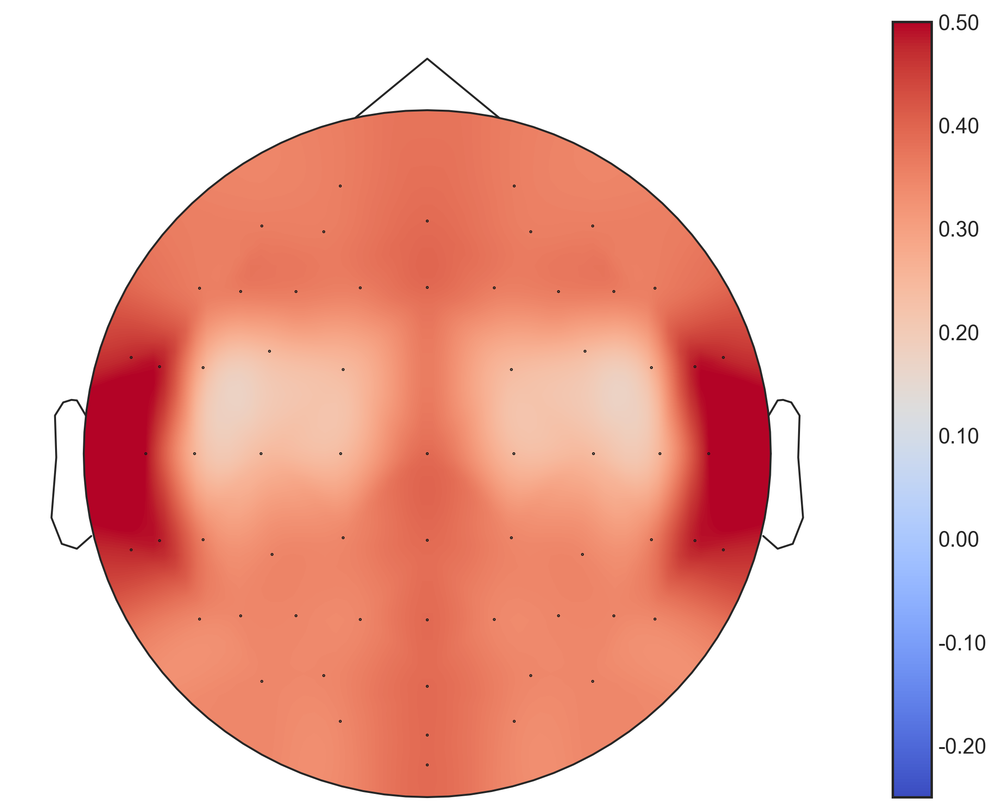

In [31]:
central_value = 0.241403
frontal_value = 0.358948
occipital_value = 0.343180
parietal_value = 0.344297
temporal_value = 0.479309
midline_value = 0.389621

plot_individual_topomap(regions, frontal_value, temporal_value, central_value, parietal_value, occipital_value, midline_value, vlim=(-0.25,0.5))

Unresponsive beta

In [32]:
beta_unresp = extract_contrast_values(df_beta_groups, 1, 'beta')
beta_unresp

{'central_value': -0.1265691256032749,
 'frontal_value': 0.42883447212083936,
 'occipital_value': 0.2566884943147895,
 'parietal_value': 0.17764687301743515,
 'temporal_value': 0.40835897376316693}

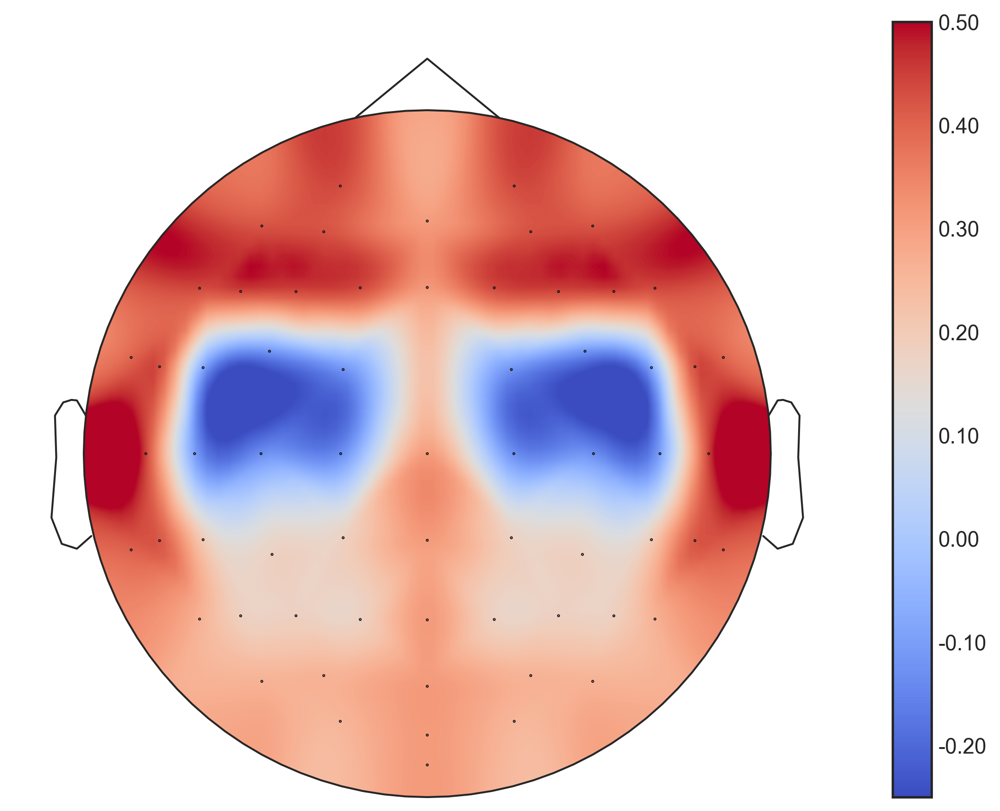

In [33]:
central_value = -0.126569
frontal_value = 0.428834
occipital_value = 0.256688
parietal_value = 0.177647
temporal_value = 0.408359
midline_value = 0.309241

plot_individual_topomap(regions, frontal_value, temporal_value, central_value, parietal_value, occipital_value, midline_value, vlim=(-0.25,0.5))

Responsive alpha

In [34]:
alpha_resp = extract_contrast_values(df_alpha_groups, 0, 'alpha')
alpha_resp

{'central_value': 0.11726363808856305,
 'frontal_value': 0.082872844573356,
 'occipital_value': 0.2378787583555551,
 'parietal_value': 0.1773964778578507,
 'temporal_value': 0.1582349993441326}

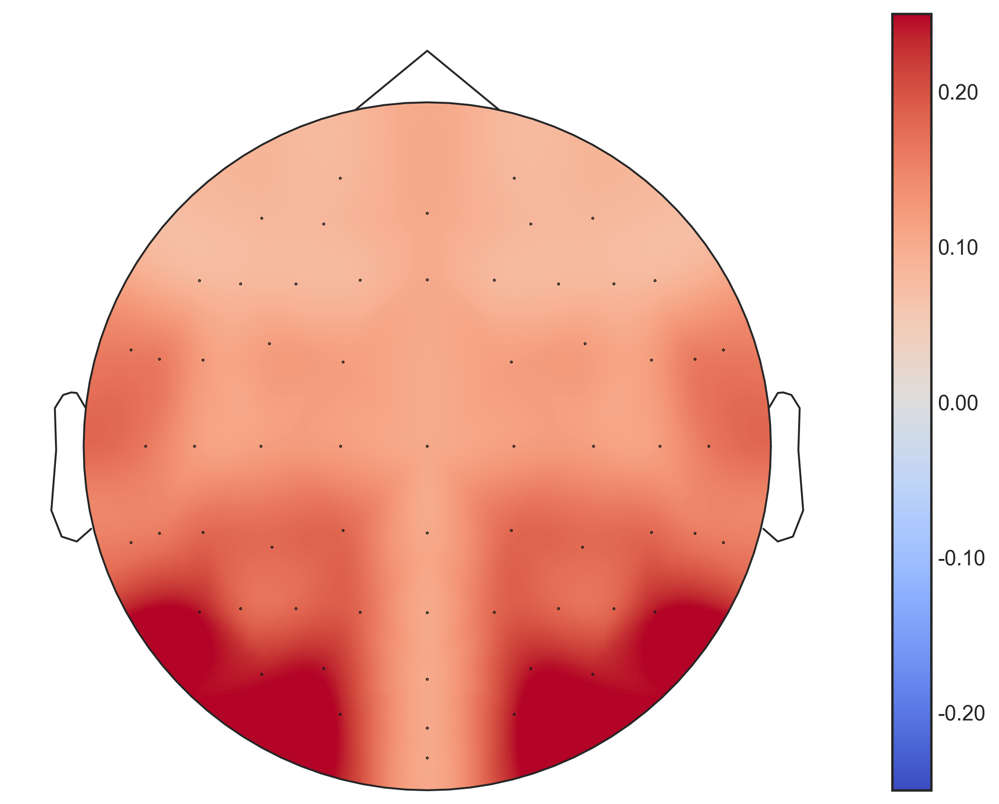

In [35]:
central_value= 0.11726363808856305
frontal_value= 0.082872844573356
occipital_value= 0.2378787583555551
parietal_value= 0.1773964778578507
temporal_value= 0.1582349993441326
midline_value= 0.103583

plot_individual_topomap(regions, frontal_value, temporal_value, central_value, parietal_value, occipital_value, midline_value, vlim = (-0.25,0.25))

Alpha unresponsive

In [36]:
alpha_unresp = extract_contrast_values(df_alpha_groups, 1, 'alpha')
alpha_unresp

{'central_value': 0.271217797762072,
 'frontal_value': -0.10501771654314987,
 'occipital_value': 0.11684619973940495,
 'parietal_value': 0.04095375096192053,
 'temporal_value': -0.015421511806870881}

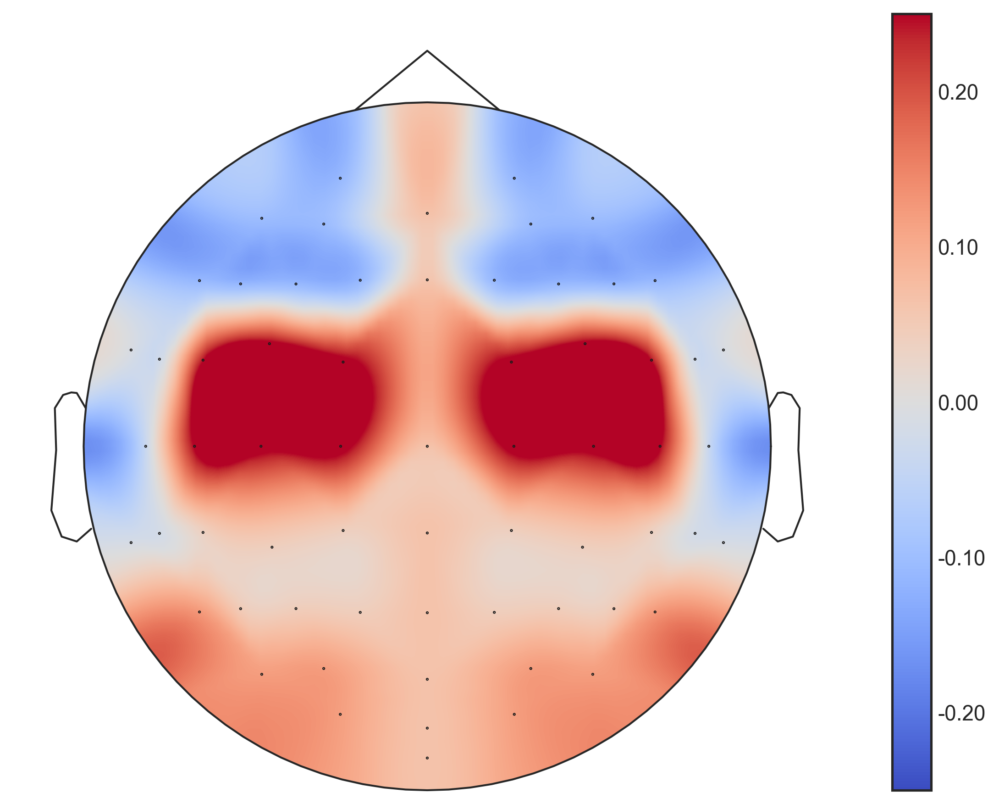

In [37]:
central_value = 0.271217797762072
frontal_value = -0.10501771654314987
occipital_value = 0.11684619973940495
parietal_value = 0.04095375096192053
temporal_value = -0.015421511806870881
midline_value = 0.064658

plot_individual_topomap(regions, frontal_value, temporal_value, central_value, parietal_value, occipital_value, midline_value, vlim = (-0.25,0.25))

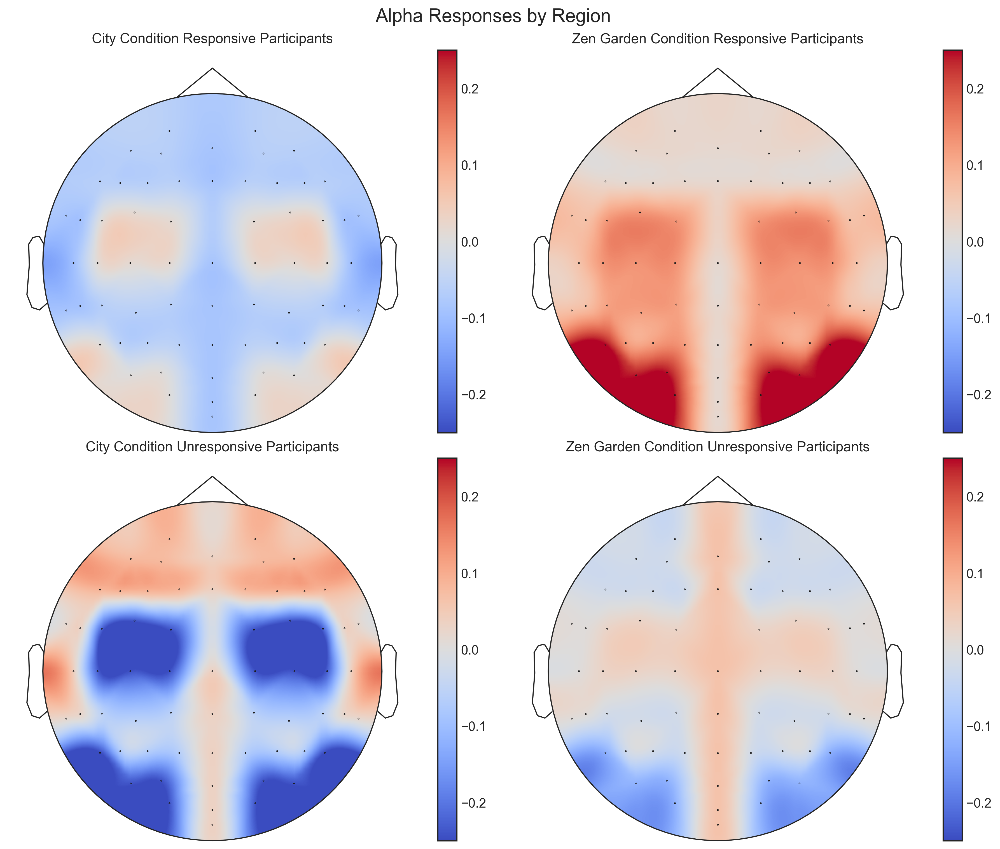

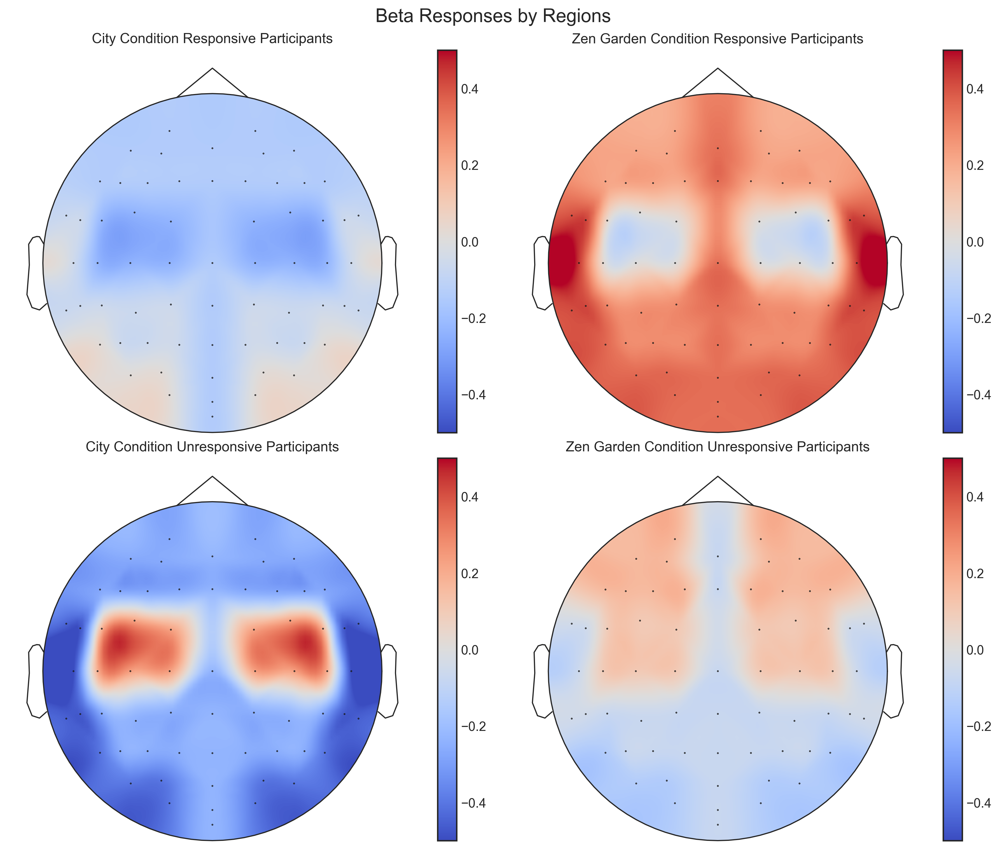

In [38]:
# Create signal info and set montage
signal_info = mne.create_info(regions['frontal'] + regions['temporal'] + regions['central'] + regions['parietal'] + regions['occipital'] + regions['midline'], 250, ch_types='eeg')
ten_twenty_montage = mne.channels.make_standard_montage('easycap-M1')
signal_info.set_montage(ten_twenty_montage)

# Define values for plotting
alpha_vals = [0.020820498535664447, 0.06990484258091732, 0.13123988004352433, 0.11581675072945374, 0.23857515075153,
              -0.06205234603769155, -0.08833015676321529, 0.01397624195496127, -0.061579727128396954, 0.0006963923959748819]

alpha_vals_un = [-0.022522060088283034, 0.0056894725927885215, 0.029997173791224355, -0.01896823259253102, -0.11559256787394427,
                 0.08249565645486684, 0.021110984399659402, -0.24122062397084765, -0.05992198355445155, -0.23243876761334922]

beta_vals = [0.21709189234264498, 0.4125164255363868, 0.005734900875482271, 0.2819277269078283, 0.3543351289166286,
             -0.14185561024827953, -0.06679273300087307, -0.23566809320175097, -0.06236966825806135, 0.011154975037981735]

beta_vals_un = [0.15969993999178891, -0.04725592587151601, 0.10393957707201729, -0.0708551516002107, -0.13746673753687044,
                -0.2691345321290504, -0.45561489963468293, 0.2305087026752922, -0.24850202461764584, -0.39415523185165996]

# Plotting function
def plot_topomaps(ax, vals, signal_info, title, vlim=None):
    if vlim is None:
        vlim = (-np.max(np.abs(vals)), np.max(np.abs(vals))) 
    im, _ = mne.viz.plot_topomap(vals, signal_info, axes=ax, cmap='coolwarm', contours=0, vlim=vlim, show=False)
    ax.set_title(title)
    return im

# Alpha Figure
fig_alpha, axs_alpha = plt.subplots(2, 2, figsize=(12, 10), constrained_layout=True)
fig_alpha.suptitle('Alpha Responses by Region', fontsize=16)

# Alpha Responsive (Condition 0: Zen Garden)
im = plot_topomaps(axs_alpha[0, 1], list(np.ones(len(regions['frontal'])) * alpha_vals[0])
                                   + list(np.ones(len(regions['temporal'])) * alpha_vals[1])
                                   + list(np.ones(len(regions['central'])) * alpha_vals[2])
                                   + list(np.ones(len(regions['parietal'])) * alpha_vals[3])
                                   + list(np.ones(len(regions['occipital'])) * alpha_vals[4])
                                   + list(np.ones(len(regions['midline'])) * 0.017610), 
                  signal_info, 'Zen Garden Condition Responsive Participants', vlim=(-0.25,0.25))
fig_alpha.colorbar(im, ax=axs_alpha[0, 0], orientation='vertical')

# Alpha Responsive (Condition 1: City)
im = plot_topomaps(axs_alpha[0, 0], list(np.ones(len(regions['frontal'])) * alpha_vals[5])
                                   + list(np.ones(len(regions['temporal'])) * alpha_vals[6])
                                   + list(np.ones(len(regions['central'])) * alpha_vals[7])
                                   + list(np.ones(len(regions['parietal'])) * alpha_vals[8])
                                   + list(np.ones(len(regions['occipital'])) * alpha_vals[9])
                                   + list(np.ones(len(regions['midline'])) * -0.085972), 
                  signal_info, 'City Condition Responsive Participants', vlim=(-0.25,0.25))
fig_alpha.colorbar(im, ax=axs_alpha[0, 1], orientation='vertical')

# Alpha Unresponsive (Condition 0: Zen Garden)
im = plot_topomaps(axs_alpha[1, 1], list(np.ones(len(regions['frontal'])) * alpha_vals_un[0])
                                   + list(np.ones(len(regions['temporal'])) * alpha_vals_un[1])
                                   + list(np.ones(len(regions['central'])) * alpha_vals_un[2])
                                   + list(np.ones(len(regions['parietal'])) * alpha_vals_un[3])
                                   + list(np.ones(len(regions['occipital'])) * alpha_vals_un[4])
                                   + list(np.ones(len(regions['midline'])) * 0.064658), 
                  signal_info, 'Zen Garden Condition Unresponsive Participants', vlim=(-0.25,0.25))
fig_alpha.colorbar(im, ax=axs_alpha[1, 0], orientation='vertical')

# Alpha Unresponsive (Condition 1: City)
im = plot_topomaps(axs_alpha[1, 0], list(np.ones(len(regions['frontal'])) * alpha_vals_un[5])
                                   + list(np.ones(len(regions['temporal'])) * alpha_vals_un[6])
                                   + list(np.ones(len(regions['central'])) * alpha_vals_un[7])
                                   + list(np.ones(len(regions['parietal'])) * alpha_vals_un[8])
                                   + list(np.ones(len(regions['occipital'])) * alpha_vals_un[9])
                                   + list(np.ones(len(regions['midline'])) * 0.034778), 
                  signal_info, 'City Condition Unresponsive Participants', vlim=(-0.25,0.25))
fig_alpha.colorbar(im, ax=axs_alpha[1, 1], orientation='vertical')

# Beta Figure
fig_beta, axs_beta = plt.subplots(2, 2, figsize=(12, 10), constrained_layout=True)
fig_beta.suptitle('Beta Responses by Regions', fontsize=16)

# Beta Responsive (Condition 0: Zen Garden)
im = plot_topomaps(axs_beta[0, 1], list(np.ones(len(regions['frontal'])) * beta_vals[0])
                                   + list(np.ones(len(regions['temporal'])) * beta_vals[1])
                                   + list(np.ones(len(regions['central'])) * beta_vals[2])
                                   + list(np.ones(len(regions['parietal'])) * beta_vals[3])
                                   + list(np.ones(len(regions['occipital'])) * beta_vals[4])
                                   + list(np.ones(len(regions['midline'])) * 0.343671), 
                  signal_info, 'Zen Garden Condition Responsive Participants', vlim=(-0.5, 0.5))
fig_beta.colorbar(im, ax=axs_beta[0, 0], orientation='vertical')

# Beta Responsive (Condition 1: City)
im = plot_topomaps(axs_beta[0, 0], list(np.ones(len(regions['frontal'])) * beta_vals[5])
                                   + list(np.ones(len(regions['temporal'])) * beta_vals[6])
                                   + list(np.ones(len(regions['central'])) * beta_vals[7])
                                   + list(np.ones(len(regions['parietal'])) * beta_vals[8])
                                   + list(np.ones(len(regions['occipital'])) * beta_vals[9])
                                   + list(np.ones(len(regions['midline'])) * -0.143178), 
                  signal_info, 'City Condition Responsive Participants', vlim=(-0.5, 0.5))
fig_beta.colorbar(im, ax=axs_beta[0, 1], orientation='vertical')

# Beta Unresponsive (Condition 0: Zen Garden)
im = plot_topomaps(axs_beta[1, 1], list(np.ones(len(regions['frontal'])) * beta_vals_un[0])
                                   + list(np.ones(len(regions['temporal'])) * beta_vals_un[1])
                                   + list(np.ones(len(regions['central'])) * beta_vals_un[2])
                                   + list(np.ones(len(regions['parietal'])) * beta_vals_un[3])
                                   + list(np.ones(len(regions['occipital'])) * beta_vals_un[4])
                                   + list(np.ones(len(regions['midline'])) * -0.073285), 
                  signal_info, 'Zen Garden Condition Unresponsive Participants', vlim=(-0.5, 0.5))
fig_beta.colorbar(im, ax=axs_beta[1, 0], orientation='vertical')

# Beta Unresponsive (Condition 1: City)
im = plot_topomaps(axs_beta[1, 0], list(np.ones(len(regions['frontal'])) * beta_vals_un[5])
                                   + list(np.ones(len(regions['temporal'])) * beta_vals_un[6])
                                   + list(np.ones(len(regions['central'])) * beta_vals_un[7])
                                   + list(np.ones(len(regions['parietal'])) * beta_vals_un[8])
                                   + list(np.ones(len(regions['occipital'])) * beta_vals_un[9])
                                   + list(np.ones(len(regions['midline'])) * -0.231145), 
                  signal_info, 'City Condition Unresponsive Participants', vlim=(-0.5, 0.5))
fig_beta.colorbar(im, ax=axs_beta[1, 1], orientation='vertical')

plt.show()


____________

# ANCIENS CODES A IGNORER ? OU RETRAVAILLER NORMALISATION etc ?

# Violin plots to visualize condition x group

In [64]:
melted_data_new = pd.read_csv(join('..', 'Data', 'melted_data_new.csv'))
melted_data_new['condition'] = melted_data_new['condition'].apply(lambda x: 1 if x == 0 else 0)
melted_data_new['group'] = melted_data_new['group'].apply(lambda x: 1 if x == 0 else 0)
melted_data_new.head()

,ID,condition,group,variable,value
0,0,1,0,LF_avg,-1.000042
1,0,0,0,LF_avg,0.788081
2,1,1,0,LF_avg,-0.367402
3,1,0,0,LF_avg,1.989455
4,2,1,1,LF_avg,-0.852645


## CHANGER LE SCALE CAR PAS DES ZSCORES

Alpha

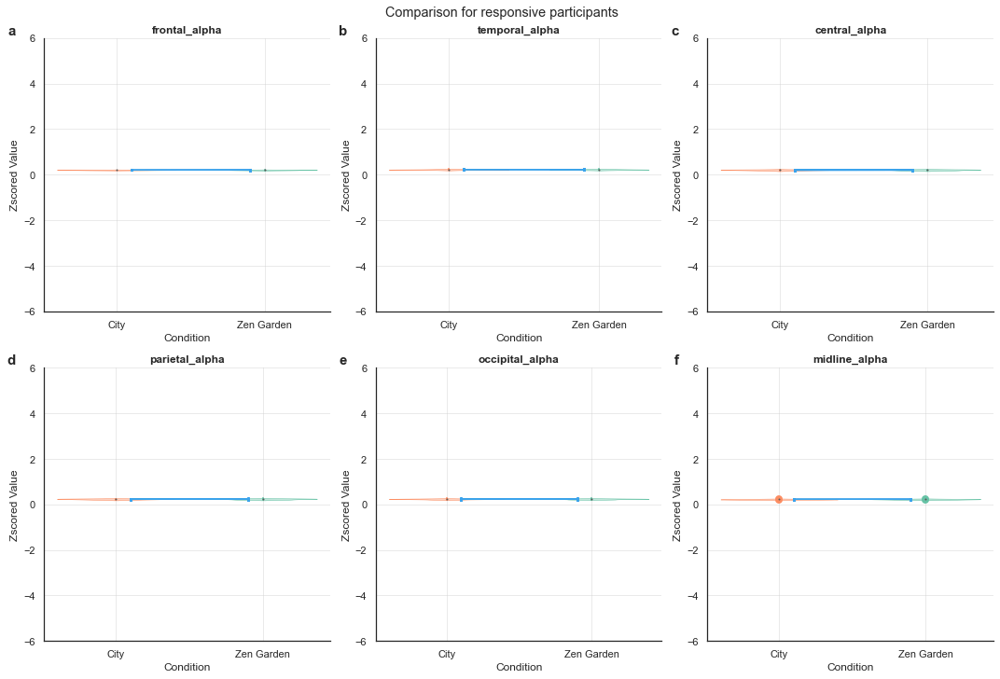

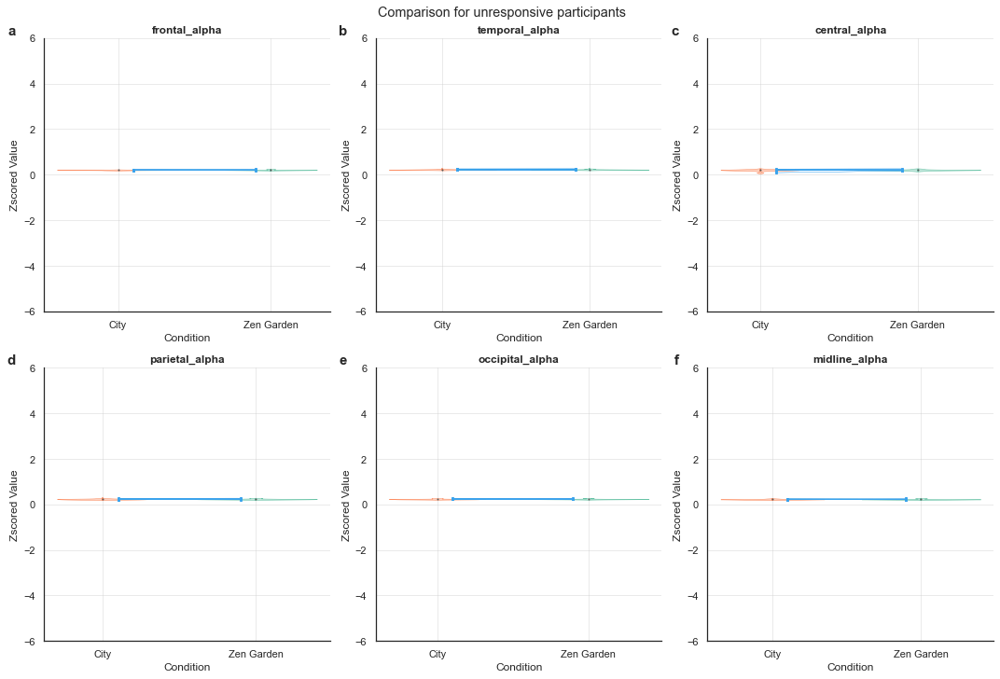

In [70]:
# CHANGE DATASET : ALL / PRE / POST

violin_plots_EEG_regions(melted_data_EEG_alpha_regions_POST, 0, 'responsive')
violin_plots_EEG_regions(melted_data_EEG_alpha_regions_POST, 1, 'unresponsive')

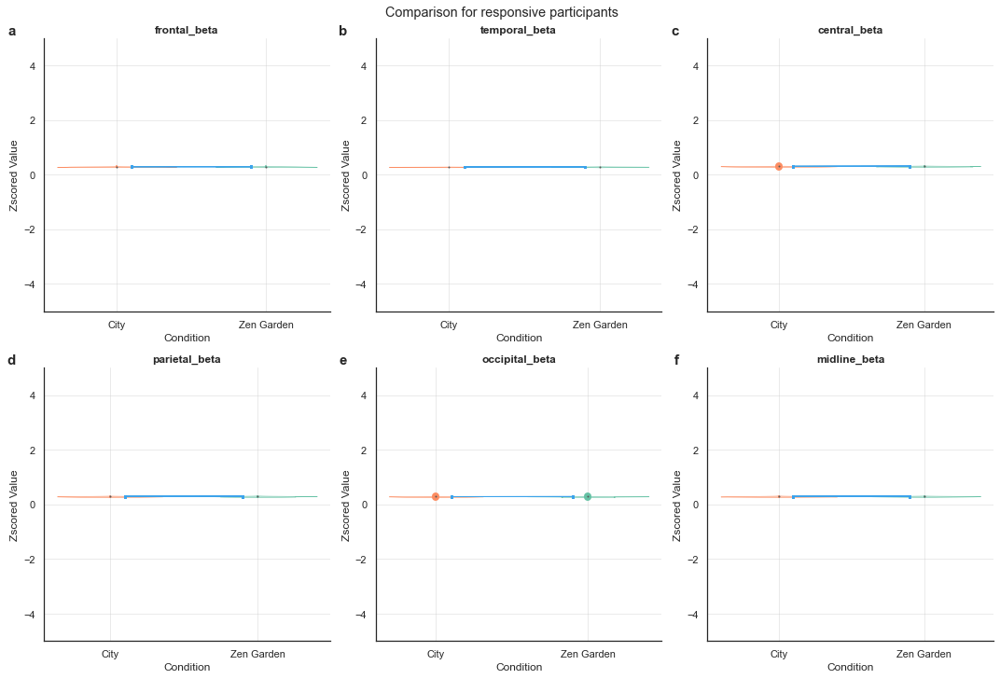

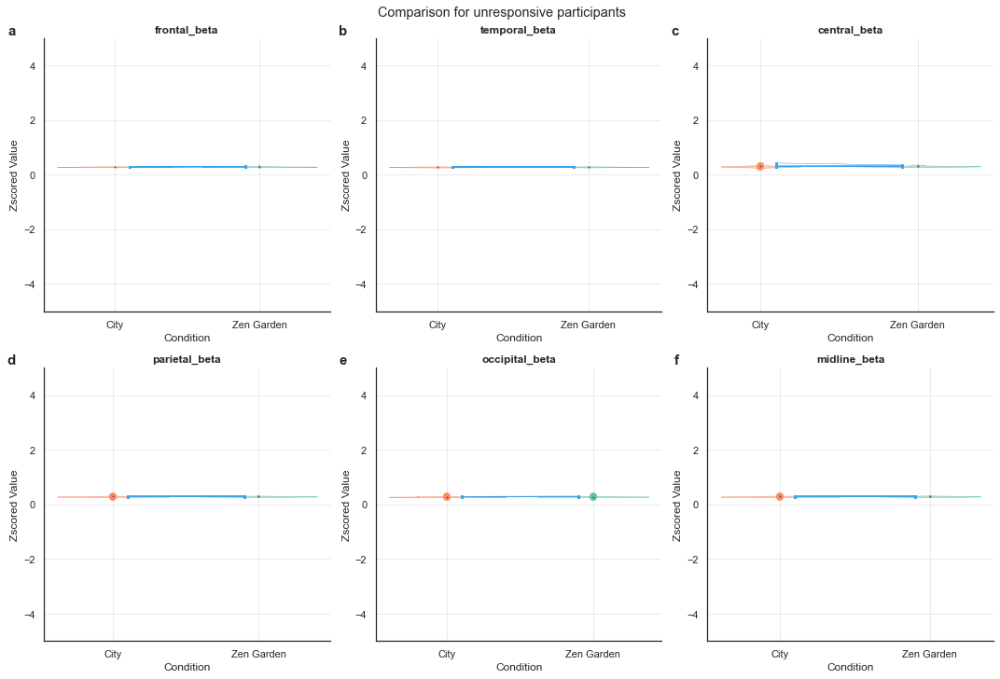

In [66]:
# CHANGE DATASET : ALL / PRE / POST
violin_plots_EEG_regions(melted_data_EEG_beta_regions_POST, 0, 'responsive', band='beta')
violin_plots_EEG_regions(melted_data_EEG_beta_regions_POST, 1, 'unresponsive', band='beta')

OLD CODE ????

In [33]:
# def means_by_region(df, group_option='all'):
#     """
#     Calculate the mean of the 'value' column in the DataFrame based on the specified group_option.
    
#     Parameters:
#     df (pd.DataFrame): The input DataFrame with columns ['ID', 'condition', 'group', 'variable', 'value'].
#     group_option (str or int): Specify whether to calculate the mean for:
#                                - 'all' (all groups combined)
#                                - 0 (only for group = 0)
#                                - 1 (only for group = 1)
                               
#     Returns:
#     pd.DataFrame: The resulting DataFrame with calculated mean values.
#     """
    
#     if group_option not in ['all', 0, 1]:
#         raise ValueError("Invalid group_option. Choose from 'all', 0, or 1.")
    
#     if group_option == 'all':
#         result_df = df.groupby(['condition', 'variable'])['value'].mean().reset_index()
    
#     else:
#         result_df = df[df['group'] == group_option].groupby(['condition', 'variable'])['value'].mean().reset_index()
    
#     return result_df

In [25]:
df_means = means_by_region(melted_data_new, group_option='all')
df_means.head()

,condition,variable,value
0,0,Fratio_avg,0.294476
1,0,HF_avg,0.423191
2,0,LF_avg,0.533457
3,0,midline_alpha,0.043021
4,0,midline_beta,0.191247


## STATISTICAL ANALYSIS (STAIY_py)

In [51]:
staiy_py = pd.read_excel('/Users/idil.sezer/Desktop/R/stai_python_parts.xlsx')
staiy_py.drop(columns=['index'], inplace=True)

staiy_py['Participant'] = staiy_py['Participant'].astype(str)
staiy_py['Participant'] = staiy_py['Participant'].apply(lambda x: x.zfill(2))
staiy_py['group'] = staiy_py['Participant'].apply(lambda x: 1 if x in unresponsive_IDs else 0)
staiy_py['score'] = (staiy_py['3D_before'] - staiy_py['3D_after']) / staiy_py['before']
staiy_py.head()

,Participant,index,before,between,after,order,2D_before,2D_after,3D_before,3D_after
0,0,0,35,35,29,0,35,35,35,29
1,1,0,22,31,22,0,22,31,31,22
2,2,1,35,34,34,0,35,34,34,34
3,4,3,22,28,21,0,22,28,28,21
4,5,4,39,37,30,0,39,37,37,30
5,6,5,25,20,20,0,25,20,20,20
6,7,6,29,27,28,1,27,28,29,27
7,8,7,26,30,23,0,26,30,30,23
8,9,8,42,25,26,1,25,26,42,25
9,10,9,21,25,24,1,25,24,21,25


In [55]:
dfzs = staiy_py.copy(deep=True)
dfzs['Participant'] = dfzs['Participant'].astype(int)
dfzs.head()

,Participant,before,between,after,order,2D_before,2D_after,3D_before,3D_after,group,score
0,0,35,35,29,0,35,35,35,29,0,0.171429
1,1,22,31,22,0,22,31,31,22,0,0.409091
2,2,35,34,34,0,35,34,34,34,1,0.000000
3,4,22,28,21,0,22,28,28,21,0,0.318182
4,5,39,37,30,0,39,37,37,30,0,0.179487
5,6,25,20,20,0,25,20,20,20,1,0.000000
6,7,29,27,28,1,27,28,29,27,0,0.068966
7,8,26,30,23,0,26,30,30,23,0,0.269231
8,9,42,25,26,1,25,26,42,25,0,0.404762
9,10,21,25,24,1,25,24,21,25,1,-0.190476


In [56]:
melted_data_new

,ID,condition,group,variable,value
0,0,1,0,LF_avg,-0.968471
1,0,0,0,LF_avg,0.820515
2,1,1,0,LF_avg,-0.335525
3,1,0,0,LF_avg,2.022470
4,2,1,1,LF_avg,-0.821003
...,...,...,...,...,...
373,32,0,1,midline_beta,-1.456500
374,33,1,0,midline_beta,-0.741137
375,33,0,0,midline_beta,-0.258863
376,34,1,1,midline_beta,-0.681966


In [57]:
corrs = melted_data_new.copy(deep=True)
corrs['Participant'] = corrs['ID'].astype(int)
corrs = corrs.merge(dfzs[['Participant', 'score']], on='Participant', how='left')
corrs

,ID,condition,group,variable,value,Participant,score
0,0,1,0,LF_avg,-0.968471,0,0.171429
1,0,0,0,LF_avg,0.820515,0,0.171429
2,1,1,0,LF_avg,-0.335525,1,0.409091
3,1,0,0,LF_avg,2.022470,1,0.409091
4,2,1,1,LF_avg,-0.821003,2,0.000000
...,...,...,...,...,...,...,...
373,32,0,1,midline_beta,-1.456500,32,0.000000
374,33,1,0,midline_beta,-0.741137,33,2.041667
375,33,0,0,midline_beta,-0.258863,33,2.041667
376,34,1,1,midline_beta,-0.681966,34,-0.178571


In [58]:
filtered_df = corrs[corrs['condition'] == 0]

# Step 2: Prepare to store results
results = []

# Step 3: Loop over each variable in the metrics_list
for variable in filtered_df['variable'].unique():
    # Filter data for the current variable
    variable_df = filtered_df[filtered_df['variable'] == variable]
    #print(variable_df)
    
    # Step 4: Perform Spearman correlation
    spearman_corr, p_value = spearmanr(variable_df['score'], variable_df['value'])
    
    # Store results
    results.append({
        'variable': variable,
        'spearman_corr': spearman_corr,
        'p_value': p_value
    })

# Step 5: Convert results to DataFrame for easy viewing
results_df = pd.DataFrame(results)
results_df

,variable,spearman_corr,p_value
0,LF_avg,0.144777,0.471220
1,HF_avg,0.080024,0.691529
2,Fratio_avg,0.141112,0.482637
3,tonic_mean,0.372633,0.055591
4,phasic_mean,-0.248626,0.211112
5,midline_alpha,-0.126451,0.529678
6,midline_beta,0.185095,0.355334


In [59]:
# Step 1: Filter for condition == 0
filtered_df = corrs[corrs['condition'] == 0]
results = []

# Step 3: Loop over each variable in the metrics_list
for variable in filtered_df['variable'].unique():

    variable_df = filtered_df[filtered_df['variable'] == variable]
    grouped = variable_df.groupby('ID')
    
    # Collect the score and value pairs for all IDs
    scores = []
    values = []
    
    for name, group in grouped:
        scores.extend(group['score'].values)
        values.extend(group['value'].values)
    
    # Perform Spearman correlation on the collected data
    spearman_corr, p_value = spearmanr(scores, values)
    
    results.append({
        'variable': variable,
        'spearman_corr': spearman_corr,
        'p_value': p_value
    })

results_df = pd.DataFrame(results)
results_df


,variable,spearman_corr,p_value
0,LF_avg,0.144777,0.471220
1,HF_avg,0.080024,0.691529
2,Fratio_avg,0.141112,0.482637
3,tonic_mean,0.372633,0.055591
4,phasic_mean,-0.248626,0.211112
5,midline_alpha,-0.126451,0.529678
6,midline_beta,0.185095,0.355334


In [60]:
# Step 1: Filter the DataFrame for condition == 0
filtered_corrs = corrs[corrs['condition'] == 0]

# Step 2: Prepare to store results
results = []

# Step 3: Loop over each variable in the filtered DataFrame
for variable in filtered_corrs['variable'].unique():
    # Filter data for the current variable
    variable_df = filtered_corrs[filtered_corrs['variable'] == variable]
    
    # Step 4: Fit a mixed-effects linear regression model
    model = smf.mixedlm("score ~ value", variable_df, groups=variable_df["ID"])
    result = model.fit()
    
    # Store results
    results.append({
        'variable': variable,
        'coef': result.params['value'],
        'p_value': result.pvalues['value'],
        'std_err': result.bse['value'],
        'model_summary': result.summary().as_text()
    })

results_df = pd.DataFrame(results)
print(results_df[['variable', 'coef', 'p_value', 'std_err']])


        variable      coef       p_value   std_err
0         LF_avg -0.032077  2.495650e-03  0.010608
1         HF_avg -0.087859  1.428024e-02  0.035859
2     Fratio_avg  0.192526  2.673382e-60  0.011754
3     tonic_mean  0.100368  5.577346e-05  0.024905
4    phasic_mean -0.080815  3.229593e-01  0.081764
5  midline_alpha -0.138754  0.000000e+00  0.002599
6   midline_beta  0.013138  6.634489e-01  0.030191


/opt/homebrew/anaconda3/envs/Venv/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/opt/homebrew/anaconda3/envs/Venv/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/opt/homebrew/anaconda3/envs/Venv/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/opt/homebrew/anaconda3/envs/Venv/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, Converge

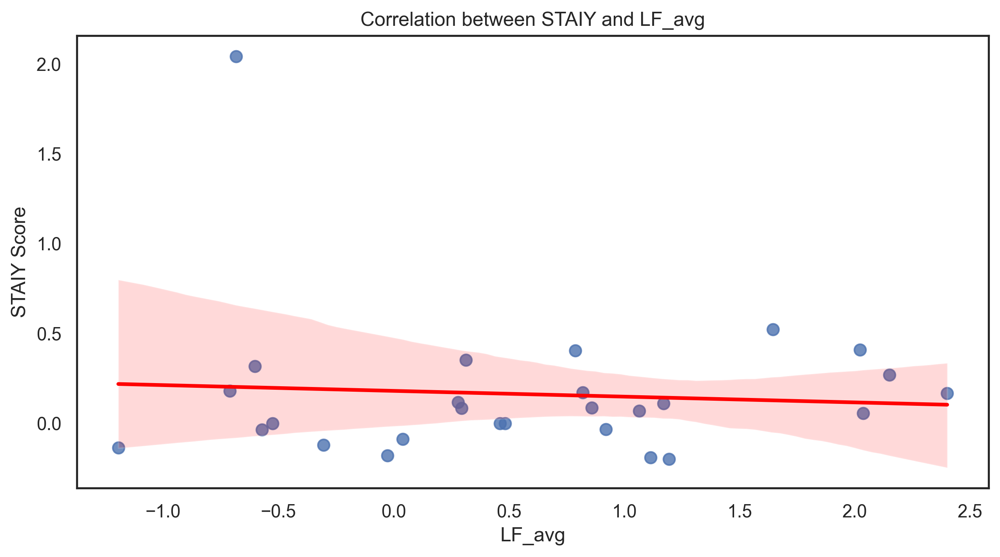

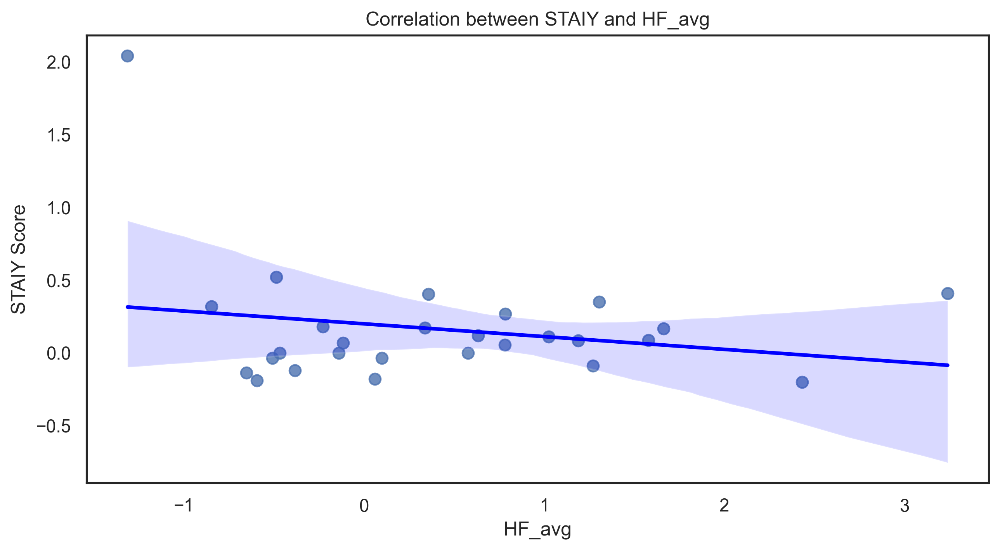

In [61]:
# Filter data for STAIY before-after/baseline and HF/LF
staiy_lf = filtered_corrs[(filtered_corrs['variable'] == 'LF_avg')]
staiy_hf = filtered_corrs[(filtered_corrs['variable'] == 'HF_avg')]

# Plot STAIY vs LF
plt.figure(figsize=(10, 5))
sns.regplot(x='value', y='score', data=staiy_lf, scatter_kws={'s':50}, line_kws={'color':'red'})
plt.title('Correlation between STAIY and LF_avg')
plt.xlabel('LF_avg')
plt.ylabel('STAIY Score')
plt.show()

# Plot STAIY vs HF
plt.figure(figsize=(10, 5))
sns.regplot(x='value', y='score', data=staiy_hf, scatter_kws={'s':50}, line_kws={'color':'blue'})
plt.title('Correlation between STAIY and HF_avg')
plt.xlabel('HF_avg')
plt.ylabel('STAIY Score')
plt.show()


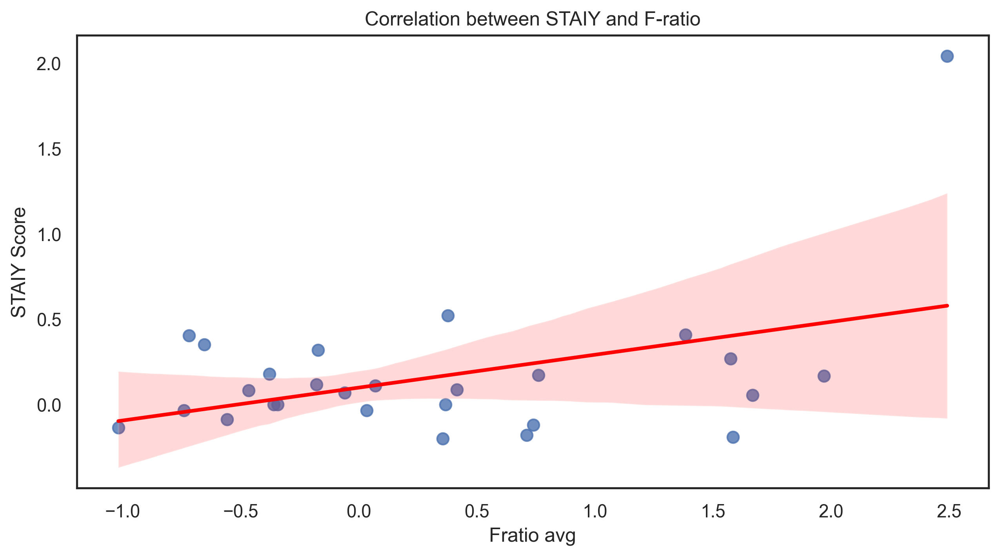

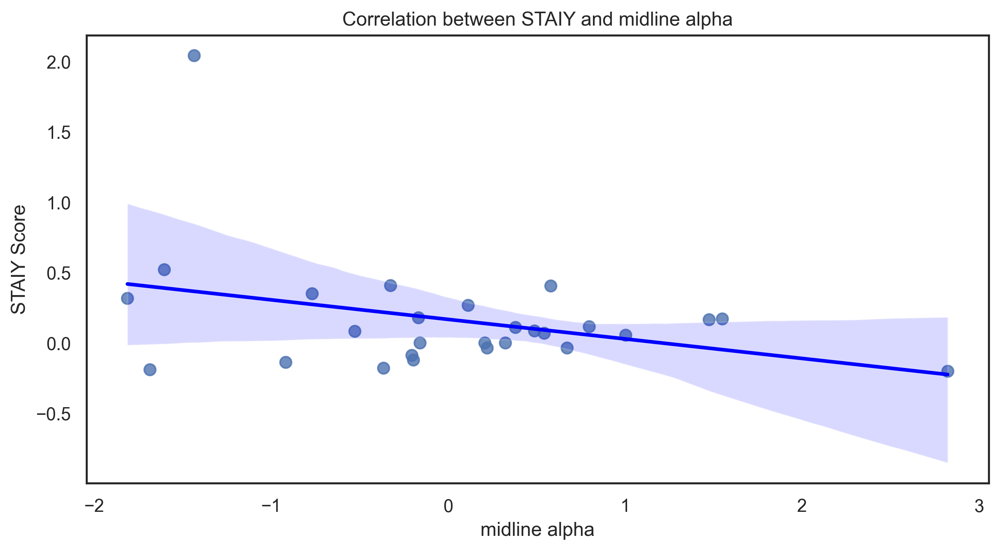

In [62]:
# Filter data for STAIY before-after/baseline and HF/LF
staiy_fratio = filtered_corrs[(filtered_corrs['variable'] == 'Fratio_avg')]
staiy_alpha = filtered_corrs[(filtered_corrs['variable'] == 'midline_alpha')]

# Plot STAIY vs LF
plt.figure(figsize=(10, 5))
sns.regplot(x='value', y='score', data=staiy_fratio, scatter_kws={'s':50}, line_kws={'color':'red'})
plt.title('Correlation between STAIY and F-ratio')
plt.xlabel('Fratio avg')
plt.ylabel('STAIY Score')
plt.show()

# Plot STAIY vs HF
plt.figure(figsize=(10, 5))
sns.regplot(x='value', y='score', data=staiy_alpha, scatter_kws={'s':50}, line_kws={'color':'blue'})
plt.title('Correlation between STAIY and midline alpha')
plt.xlabel('midline alpha')
plt.ylabel('STAIY Score')
plt.show()

In [63]:
coeffs = pd.read_csv('/Users/idil.sezer/Desktop/R/coupling_coeffs.csv')
coeffs

,ID,group,variable,value,condition
0,0,0,B2HF,0.020959,1
1,1,0,B2HF,0.000923,1
2,2,1,B2HF,0.011812,1
3,4,0,B2HF,0.004471,1
4,5,0,B2HF,0.006211,1
...,...,...,...,...,...
211,30,1,LF2B,2.550470,0
212,31,0,LF2B,0.066665,0
213,32,1,LF2B,0.446551,0
214,33,0,LF2B,0.085818,0


In [64]:
dfzs.head()

,Participant,before,between,after,order,2D_before,2D_after,3D_before,3D_after,group,score
0,0,35,35,29,0,35,35,35,29,0,0.171429
1,1,22,31,22,0,22,31,31,22,0,0.409091
2,2,35,34,34,0,35,34,34,34,1,0.000000
3,4,22,28,21,0,22,28,28,21,0,0.318182
4,5,39,37,30,0,39,37,37,30,0,0.179487
5,6,25,20,20,0,25,20,20,20,1,0.000000
6,7,29,27,28,1,27,28,29,27,0,0.068966
7,8,26,30,23,0,26,30,30,23,0,0.269231
8,9,42,25,26,1,25,26,42,25,0,0.404762
9,10,21,25,24,1,25,24,21,25,1,-0.190476


In [65]:
coeffs['Participant'] = coeffs['ID'].astype(int)
coeffs = coeffs.merge(dfzs[['Participant', 'score']], on='Participant', how='left')
coeffs

,ID,group,variable,value,condition,Participant,score
0,0,0,B2HF,0.020959,1,0,0.171429
1,1,0,B2HF,0.000923,1,1,0.409091
2,2,1,B2HF,0.011812,1,2,0.000000
3,4,0,B2HF,0.004471,1,4,0.318182
4,5,0,B2HF,0.006211,1,5,0.179487
...,...,...,...,...,...,...,...
211,30,1,LF2B,2.550470,0,30,-0.136364
212,31,0,LF2B,0.066665,0,31,0.055556
213,32,1,LF2B,0.446551,0,32,0.000000
214,33,0,LF2B,0.085818,0,33,2.041667


In [66]:
pd.options.display.float_format = '{:.10e}'.format

# Step 1: Filter the DataFrame for condition == 0
filtered_corrs = coeffs[coeffs['condition'] == 0]

# Step 2: Prepare to store results
results = []

# Step 3: Loop over each variable in the filtered DataFrame
for variable in filtered_corrs['variable'].unique():
    # Filter data for the current variable
    variable_df = filtered_corrs[filtered_corrs['variable'] == variable]
    print(variable_df['value'].describe()) 
    
    # Step 4: Fit a mixed-effects linear regression model
    model = smf.mixedlm("score ~ value", variable_df, groups=variable_df["ID"])
    result = model.fit()
    
    # Store results
    results.append({
        'variable': variable,
        'coef': result.params['value'],
        'p_value': result.pvalues['value'],
        'std_err': result.bse['value'],
        'model_summary': result.summary().as_text()
    })

# Step 5: Convert results to DataFrame for easy viewing
results_df = pd.DataFrame(results)

# Display the results
print(results_df[['variable', 'coef', 'p_value', 'std_err']])
print(result.summary().as_text())


count   2.7000000000e+01
mean    9.2504030571e-03
std     7.2233218344e-03
min     1.5175547753e-03
25%     4.2074447663e-03
50%     7.3058929031e-03
75%     1.0249123808e-02
max     3.3205691442e-02
Name: value, dtype: float64
count    2.7000000000e+01
mean     2.7970945253e-03
std      3.5680408222e-03
min     -8.5883860226e-03
25%      1.1548611523e-03
50%      2.8711627715e-03
75%      4.3622806902e-03
max      9.5977658625e-03
Name: value, dtype: float64
count   2.7000000000e+01
mean    1.9331160797e+00
std     2.7904024730e+00
min     9.8093948645e-02
25%     4.4224810549e-01
50%     6.7092347656e-01
75%     1.3515634174e+00
max     1.0397350476e+01
Name: value, dtype: float64
count   2.7000000000e+01
mean    6.4154961978e-01
std     1.0185012144e+00
min     6.6665492989e-02
25%     1.6680442968e-01
50%     2.5991548975e-01
75%     5.3387290474e-01
max     4.8837691250e+00
Name: value, dtype: float64
  variable              coef          p_value          std_err
0     B2HF  2.421

/opt/homebrew/anaconda3/envs/Venv/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/opt/homebrew/anaconda3/envs/Venv/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/opt/homebrew/anaconda3/envs/Venv/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, ConvergenceWarning)
/opt/homebrew/anaconda3/envs/Venv/lib/python3.9/site-packages/statsmodels/regression/mixed_linear_model.py:2261: ConvergenceWarning: The Hessian matrix at the estimated parameter values is not positive definite.
  warnings.warn(msg, Converge

In [67]:
# Set floating-point format for scientific notation
pd.options.display.float_format = '{:.10e}'.format

# Step 1: Filter the DataFrame for condition == 0
filtered_corrs = coeffs[coeffs['condition'] == 0]

# Step 2: Prepare to store results
results = []

# Step 3: Loop over each variable in the filtered DataFrame
for variable in filtered_corrs['variable'].unique():
    # Filter data for the current variable
    variable_df = filtered_corrs[filtered_corrs['variable'] == variable]
    #print(variable_df['value'].describe()) 
    
    # Step 4: Fit a simple linear regression model
    model = smf.ols("score ~ value", data=variable_df).fit()
    
    # Store results
    results.append({
        'variable': variable,
        'coef': model.params['value'],
        'p_value': model.pvalues['value'],
        'std_err': model.bse['value'],
        'model_summary': model.summary().as_text()
    })

# Step 5: Convert results to DataFrame for easy viewing
results_df = pd.DataFrame(results)

# Display the results
print(results_df[['variable', 'coef', 'p_value', 'std_err']])


  variable              coef          p_value          std_err
0     B2HF  2.4216626046e+00 8.3769202685e-01 1.1699246913e+01
1     B2LF  1.2004259913e+01 6.1519950697e-01 2.3582938875e+01
2     HF2B -2.5281171479e-02 4.0562579321e-01 2.9886276329e-02
3     LF2B -3.5533115604e-02 6.7126610510e-01 8.2738765824e-02


In [68]:
coeffs

,ID,group,variable,value,condition,Participant,score
0,0,0,B2HF,2.0959288272e-02,1,0,1.7142857143e-01
1,1,0,B2HF,9.2275235270e-04,1,1,4.0909090909e-01
2,2,1,B2HF,1.1812256438e-02,1,2,0.0000000000e+00
3,4,0,B2HF,4.4709954269e-03,1,4,3.1818181818e-01
4,5,0,B2HF,6.2113132131e-03,1,5,1.7948717949e-01
...,...,...,...,...,...,...,...
211,30,1,LF2B,2.5504700563e+00,0,30,-1.3636363636e-01
212,31,0,LF2B,6.6665492989e-02,0,31,5.5555555556e-02
213,32,1,LF2B,4.4655141775e-01,0,32,0.0000000000e+00
214,33,0,LF2B,8.5817676913e-02,0,33,2.0416666667e+00


In [69]:
# Set floating-point format for scientific notation
pd.options.display.float_format = '{:.10e}'.format

# Step 1: Filter the DataFrame for condition == 0
filtered_corrs = coeffs[coeffs['condition'] == 0]

# Ensure 'score' is included in the DataFrame.
# Step 2: Pivot the DataFrame to have separate columns for each physiological variable
# Only pivot on columns that are physiological variables, ensuring 'score' is not included in the pivot.
physiological_data = filtered_corrs[['ID', 'variable', 'value', 'score']]
pivoted_data = physiological_data.pivot(index='ID', columns='variable', values='value').reset_index()

# Step 3: Merge the 'score' data back to the pivoted DataFrame.
# Assuming 'score' was part of `filtered_corrs` initially, extract it before pivoting.
score_data = filtered_corrs[['ID', 'score']].drop_duplicates()
pivoted_data = pd.merge(pivoted_data, score_data, on='ID', how='left')

# Check the prepared data
print(pivoted_data.head())
print(pivoted_data.columns)

# Step 4: Create a formula string for regression
# Ensure 'score' is your dependent variable and the predictors are the columns from pivoted_data except 'ID' and 'score'.
predictors = " + ".join([col for col in pivoted_data.columns if col not in ['ID', 'score']])
formula = f"score ~ {predictors}"

# Step 5: Fit a multiple linear regression model with all physiological variables as predictors
model = smf.ols(formula, data=pivoted_data).fit()

# Print model summary
print(model.summary())


   ID             B2HF              B2LF             HF2B             LF2B  \
0   0 3.3205691442e-02 -8.5883860226e-03 3.1701072067e-01 2.3638438881e-01   
1   1 3.4928736843e-03  8.8726550795e-03 3.4124802107e+00 1.8085952218e-01   
2   2 2.1717860867e-02 -5.1401679616e-04 2.0225252377e-01 9.3474660879e-02   
3   4 4.1907140491e-03 -1.7243992777e-04 1.0397350476e+01 4.8837691250e+00   
4   5 7.1559927675e-03  2.4910549241e-03 3.1857015047e-01 2.7410096313e-01   

             score  
0 1.7142857143e-01  
1 4.0909090909e-01  
2 0.0000000000e+00  
3 3.1818181818e-01  
4 1.7948717949e-01  
Index(['ID', 'B2HF', 'B2LF', 'HF2B', 'LF2B', 'score'], dtype='object')
                            OLS Regression Results                            
Dep. Variable:                  score   R-squared:                       0.062
Model:                            OLS   Adj. R-squared:                 -0.109
Method:                 Least Squares   F-statistic:                    0.3636
Date:             

In [70]:
# Set floating-point format for scientific notation
pd.options.display.float_format = '{:.10e}'.format

# Step 1: Filter the DataFrame for condition == 0
filtered_corrs = coeffs[coeffs['condition'] == 0]

# Ensure 'score' is included in the DataFrame.
# Step 2: Create a DataFrame with physiological data and corresponding 'score'
# Extract relevant columns and pivot for physiological data
physiological_data = filtered_corrs[['ID', 'variable', 'value']]

# Pivot the DataFrame to have separate columns for each physiological variable
pivoted_data = physiological_data.pivot(index='ID', columns='variable', values='value').reset_index()

# Merge the 'score' data back to the pivoted DataFrame
# Extract 'score' from the original filtered_corrs DataFrame
score_data = filtered_corrs[['ID', 'score']].drop_duplicates()
pivoted_data = pd.merge(pivoted_data, score_data, on='ID', how='left')

# Check the prepared data
print(pivoted_data.head())
print(pivoted_data.columns)

# Step 3: Create a formula string for regression
# Ensure 'score' is your dependent variable and the predictors are the columns from pivoted_data except 'ID' and 'score'.
predictors = " + ".join([col for col in pivoted_data.columns if col not in ['ID', 'score']])
formula = f"score ~ {predictors}"

# Step 4: Fit a multiple linear regression model with all physiological variables as predictors
model = smf.ols(formula, data=pivoted_data).fit()

# Extract p-values and coefficients
results_df = pd.DataFrame({
    'variable': model.params.index[1:],  # Exclude the Intercept
    'coef': model.params.values[1:],     # Exclude the Intercept
    'p_value': model.pvalues.values[1:],  # Exclude the Intercept
    'std_err': model.bse.values[1:]       # Exclude the Intercept
})

# Print the results
print(results_df)

# Optionally, print the model summary
print(model.summary())


   ID             B2HF              B2LF             HF2B             LF2B  \
0   0 3.3205691442e-02 -8.5883860226e-03 3.1701072067e-01 2.3638438881e-01   
1   1 3.4928736843e-03  8.8726550795e-03 3.4124802107e+00 1.8085952218e-01   
2   2 2.1717860867e-02 -5.1401679616e-04 2.0225252377e-01 9.3474660879e-02   
3   4 4.1907140491e-03 -1.7243992777e-04 1.0397350476e+01 4.8837691250e+00   
4   5 7.1559927675e-03  2.4910549241e-03 3.1857015047e-01 2.7410096313e-01   

             score  
0 1.7142857143e-01  
1 4.0909090909e-01  
2 0.0000000000e+00  
3 3.1818181818e-01  
4 1.7948717949e-01  
Index(['ID', 'B2HF', 'B2LF', 'HF2B', 'LF2B', 'score'], dtype='object')
  variable              coef          p_value          std_err
0     B2HF  1.0339809717e+01 6.7597432644e-01 2.4409694484e+01
1     B2LF  3.2629298908e+01 4.7663452776e-01 4.5061861401e+01
2     HF2B -4.7219427354e-02 4.4077392938e-01 6.0145232318e-02
3     LF2B  1.2200287480e-01 4.7318889838e-01 1.6716411931e-01
                   

In [71]:
# Set floating-point format for scientific notation
pd.options.display.float_format = '{:.10e}'.format

# Step 1: Filter the DataFrame for condition == 0
filtered_corrs = coeffs[coeffs['condition'] == 0]

# Ensure 'score' is included in the DataFrame.
# Step 2: Create a DataFrame with physiological data and corresponding 'score'
physiological_data = filtered_corrs[['ID', 'variable', 'value']]

# Pivot the DataFrame to have separate columns for each physiological variable
pivoted_data = physiological_data.pivot(index='ID', columns='variable', values='value').reset_index()

# Merge the 'score' data back to the pivoted DataFrame
score_data = filtered_corrs[['ID', 'score']].drop_duplicates()
pivoted_data = pd.merge(pivoted_data, score_data, on='ID', how='left')

# Check the prepared data
print(pivoted_data.head())
print(pivoted_data.columns)

# Step 3: Create a formula string for regression
# Ensure 'score' is your dependent variable and the predictors are the columns from pivoted_data except 'ID' and 'score'.
predictors = " + ".join([col for col in pivoted_data.columns if col not in ['ID', 'score']])
formula = f"score ~ {predictors}"

# Step 4: Fit a multiple linear regression model with all physiological variables as predictors
model = smf.ols(formula, data=pivoted_data).fit()

# Extract p-values and coefficients
results_df = pd.DataFrame({
    'variable': model.params.index[1:],  # Exclude the Intercept
    'coef': model.params.values[1:],     # Exclude the Intercept
    'p_value': model.pvalues.values[1:],  # Exclude the Intercept
    'std_err': model.bse.values[1:]       # Exclude the Intercept
})

# Print the results
print(results_df)

# Optionally, print the model summary
print(model.summary())


   ID             B2HF              B2LF             HF2B             LF2B  \
0   0 3.3205691442e-02 -8.5883860226e-03 3.1701072067e-01 2.3638438881e-01   
1   1 3.4928736843e-03  8.8726550795e-03 3.4124802107e+00 1.8085952218e-01   
2   2 2.1717860867e-02 -5.1401679616e-04 2.0225252377e-01 9.3474660879e-02   
3   4 4.1907140491e-03 -1.7243992777e-04 1.0397350476e+01 4.8837691250e+00   
4   5 7.1559927675e-03  2.4910549241e-03 3.1857015047e-01 2.7410096313e-01   

             score  
0 1.7142857143e-01  
1 4.0909090909e-01  
2 0.0000000000e+00  
3 3.1818181818e-01  
4 1.7948717949e-01  
Index(['ID', 'B2HF', 'B2LF', 'HF2B', 'LF2B', 'score'], dtype='object')
  variable              coef          p_value          std_err
0     B2HF  1.0339809717e+01 6.7597432644e-01 2.4409694484e+01
1     B2LF  3.2629298908e+01 4.7663452776e-01 4.5061861401e+01
2     HF2B -4.7219427354e-02 4.4077392938e-01 6.0145232318e-02
3     LF2B  1.2200287480e-01 4.7318889838e-01 1.6716411931e-01
                   

In [72]:
# Set floating-point format for scientific notation
pd.options.display.float_format = '{:.10e}'.format

# Step 1: Filter the DataFrame for condition == 0
filtered_corrs = corrs[corrs['condition'] == 0]
filtered_corrs = filtered_corrs[filtered_corrs['variable'] != 'tonic_mean']
filtered_corrs = filtered_corrs[filtered_corrs['variable'] != 'phasic_mean']


# Ensure 'score' is included in the DataFrame.
# Step 2: Create a DataFrame with physiological data and corresponding 'score'
physiological_data = filtered_corrs[['ID', 'variable', 'value']]

# Pivot the DataFrame to have separate columns for each physiological variable
pivoted_data = physiological_data.pivot(index='ID', columns='variable', values='value').reset_index()

# Merge the 'score' data back to the pivoted DataFrame
score_data = filtered_corrs[['ID', 'score']].drop_duplicates()
pivoted_data = pd.merge(pivoted_data, score_data, on='ID', how='left')

# Check the prepared data
print(pivoted_data.head())
print(pivoted_data.columns)

# Step 3: Create a formula string for regression
# Ensure 'score' is your dependent variable and the predictors are the columns from pivoted_data except 'ID' and 'score'.
predictors = " + ".join([col for col in pivoted_data.columns if col not in ['ID', 'score']])
formula = f"score ~ {predictors}"

# Step 4: Fit a multiple linear regression model with all physiological variables as predictors
model = smf.ols(formula, data=pivoted_data).fit()

# Extract p-values and coefficients
results_df = pd.DataFrame({
    'variable': model.params.index[1:],  # Exclude the Intercept
    'coef': model.params.values[1:],     # Exclude the Intercept
    'p_value': model.pvalues.values[1:],  # Exclude the Intercept
    'std_err': model.bse.values[1:]       # Exclude the Intercept
})

# Print the results
print(results_df)

# Optionally, print the model summary
print(model.summary())


   ID        Fratio_avg            HF_avg            LF_avg     midline_alpha  \
0   0  7.6035117410e-01  3.3735955341e-01  8.2051517449e-01  1.5483393509e+00   
1   1  1.3829973518e+00  3.2385323907e+00  2.0224701766e+00 -3.2650072367e-01   
2   2 -3.6101364008e-01 -1.4037959531e-01  4.8358328589e-01  3.2191644555e-01   
3   4 -1.7290272931e-01 -8.4515208072e-01 -6.0170216229e-01 -1.8126096352e+00   
4   5 -3.7885602157e-01 -2.2886204881e-01 -7.1069922503e-01 -1.6819201445e-01   

       midline_beta            score  
0 -3.4349417825e-01 1.7142857143e-01  
1  8.3728650830e-01 4.0909090909e-01  
2 -9.4902178100e-01 0.0000000000e+00  
3  1.1974743175e+00 3.1818181818e-01  
4  1.7066696185e+00 1.7948717949e-01  
Index(['ID', 'Fratio_avg', 'HF_avg', 'LF_avg', 'midline_alpha', 'midline_beta',
       'score'],
      dtype='object')
        variable              coef          p_value          std_err
0     Fratio_avg  2.6244747625e-01 1.4921681828e-02 9.8974014239e-02
1         HF_avg  1.01

In [73]:
results_df

,variable,coef,p_value,std_err
0,Fratio_avg,2.6244747625e-01,1.4921681828e-02,9.8974014239e-02
1,HF_avg,1.0102625451e-02,9.1792215622e-01,9.6862577492e-02
2,LF_avg,-1.2850650376e-01,2.7217720283e-01,1.1395704622e-01
3,midline_alpha,-1.0212839784e-01,2.6325047454e-01,8.8841492139e-02
4,midline_beta,-1.5603892625e-03,9.8469956202e-01,8.0403021389e-02


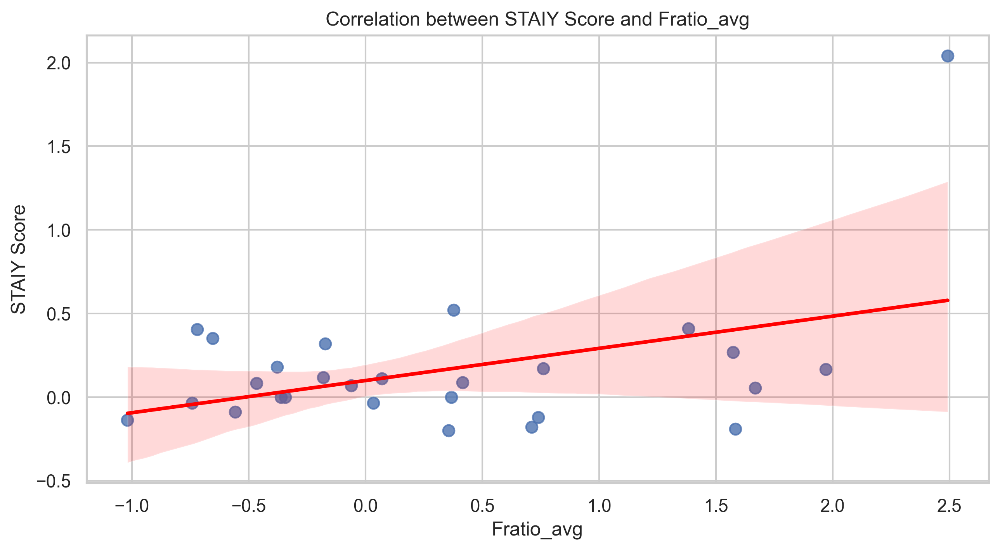

In [74]:
sns.set_style('whitegrid')
# Filter data for Fratio_avg
staiy_fratio = filtered_corrs[filtered_corrs['variable'] == 'Fratio_avg']

# Prepare DataFrame for regplot
reg_data = staiy_fratio[['value', 'score']].rename(columns={'value': 'Fratio_avg'})

# Plot STAIY vs Fratio_avg with regression line
plt.figure(figsize=(10, 5))
sns.regplot(x='Fratio_avg', y='score', data=reg_data, scatter_kws={'s':50}, line_kws={'color':'red'})
plt.title('Correlation between STAIY Score and Fratio_avg')
plt.xlabel('Fratio_avg')
plt.ylabel('STAIY Score')
plt.show()


In [75]:
# Assuming 'results_df' contains the model results
fratio_coef = results_df[results_df['variable'] == 'Fratio_avg']['coef'].values[0]
print(f"Coefficient for Fratio_avg: {fratio_coef}")


Coefficient for Fratio_avg: 0.26244747625496895


In [76]:
filtered_corrs

,ID,condition,group,variable,value,Participant,score
1,0,0,0,LF_avg,8.2051517449e-01,0,1.7142857143e-01
3,1,0,0,LF_avg,2.0224701766e+00,1,4.0909090909e-01
5,2,0,1,LF_avg,4.8358328589e-01,2,0.0000000000e+00
7,4,0,0,LF_avg,-6.0170216229e-01,4,3.1818181818e-01
9,5,0,0,LF_avg,-7.1069922503e-01,5,1.7948717949e-01
...,...,...,...,...,...,...,...
369,30,0,1,midline_beta,8.4288586903e-01,30,-1.3636363636e-01
371,31,0,0,midline_beta,-1.0080194238e+00,31,5.5555555556e-02
373,32,0,1,midline_beta,-1.4564999065e+00,32,0.0000000000e+00
375,33,0,0,midline_beta,-2.5886328697e-01,33,2.0416666667e+00


In [77]:
coeffs.to_excel('/Users/idil.sezer/Desktop/R/coeffs_LR.xlsx', index=False)

In [78]:
# number of unique ID
len(filtered_corrs['ID'].unique())

27

Coefficient for value (Fratio_avg): 0.19252581833111201


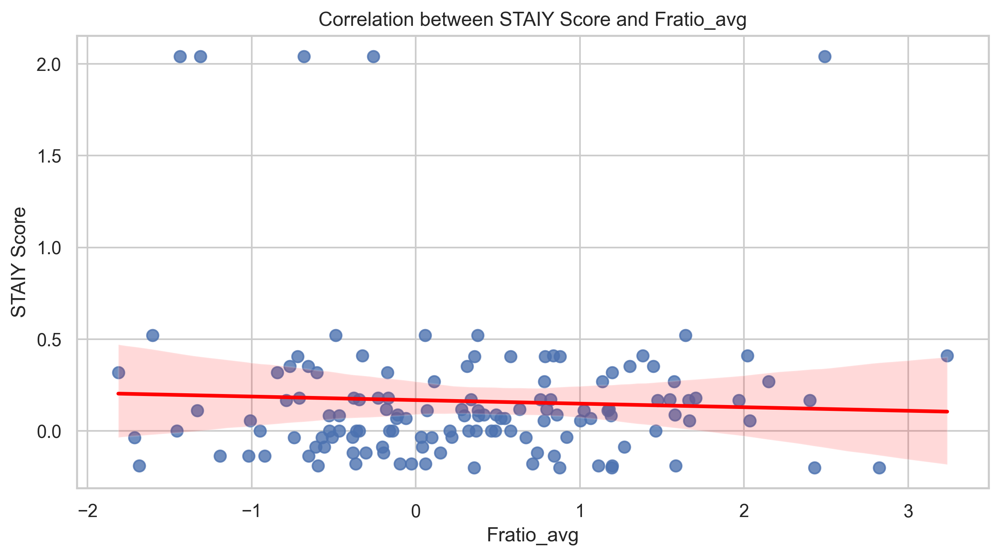

In [79]:
# Fit model

test = filtered_corrs[filtered_corrs['variable'] == 'Fratio_avg']
model = smf.ols('score ~ value', data=test).fit()

# Extract coefficient
coef_value = model.params['value']
print(f"Coefficient for value (Fratio_avg): {coef_value}")

# Plot
plt.figure(figsize=(10, 5))
sns.regplot(x='value', y='score', data=filtered_corrs, scatter_kws={'s':50}, line_kws={'color':'red'})
plt.title('Correlation between STAIY Score and Fratio_avg')
plt.xlabel('Fratio_avg')
plt.ylabel('STAIY Score')
plt.show()

In [80]:
# Example DataFrame setup
# Ensure 'corrs' DataFrame is available with 'condition', 'variable', 'value', 'ID', and 'score' columns.

# Step 1: Filter the DataFrame for condition == 0
filtered_corrs = corrs[corrs['condition'] == 0]

# List of variables to analyze
variables = filtered_corrs['variable'].unique()

# DataFrame to store results
results_list = []

# Step 2: Perform simple linear regression for each variable
for var in variables:
    if var == 'score':
        continue  # Skip 'score' variable itself

    # Filter data for the current variable
    data = filtered_corrs[filtered_corrs['variable'] == var]
    
    # Prepare data for regression
    regression_data = pd.merge(data[['ID', 'value']], filtered_corrs[['ID', 'score']], on='ID', how='left')

    # Fit a simple linear regression model
    model = sm.OLS(regression_data['score'], sm.add_constant(regression_data['value'])).fit()

    # Extract coefficients, p-values, and other statistics
    results_list.append({
        'variable': var,
        'coef': model.params['value'],
        'p_value': model.pvalues['value'],
        'std_err': model.bse['value'],
        'r_squared': model.rsquared
    })

# Convert results to a DataFrame
results_df = pd.DataFrame(results_list)

# Print results
print(results_df)

# Optionally, print detailed summary for each variable's model
for var in variables:
    if var == 'score':
        continue
    data = filtered_corrs[filtered_corrs['variable'] == var]
    regression_data = pd.merge(data[['ID', 'value']], filtered_corrs[['ID', 'score']], on='ID', how='left')
    model = sm.OLS(regression_data['score'], sm.add_constant(regression_data['value'])).fit()
    print(f"\nModel Summary for {var}:")
    print(model.summary())


        variable              coef          p_value          std_err  \
0         LF_avg -3.2077338071e-02 3.1198627015e-01 3.1640575383e-02   
1         HF_avg -8.7859077548e-02 2.4867825831e-03 2.8651162155e-02   
2     Fratio_avg  1.9252581833e-01 1.1411430532e-09 3.0025223967e-02   
3     tonic_mean  1.0036846837e-01 4.9176318462e-04 2.8293204684e-02   
4    phasic_mean -8.0814766904e-02 8.9233594145e-03 3.0580958505e-02   
5  midline_alpha -1.3875386820e-01 1.2013684635e-06 2.7642410833e-02   
6   midline_beta  1.3137619670e-02 6.7537895053e-01 3.1322106803e-02   

         r_squared  
0 5.4662040148e-03  
1 4.7878397445e-02  
2 1.8023979001e-01  
3 6.3052724474e-02  
4 3.6000974016e-02  
5 1.1874090857e-01  
6 9.3989955980e-04  

Model Summary for LF_avg:
                            OLS Regression Results                            
Dep. Variable:                  score   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:               

In [81]:
results_df

,variable,coef,p_value,std_err,r_squared
0,LF_avg,-3.2077338071e-02,3.1198627015e-01,3.1640575383e-02,5.4662040148e-03
1,HF_avg,-8.7859077548e-02,2.4867825831e-03,2.8651162155e-02,4.7878397445e-02
2,Fratio_avg,1.9252581833e-01,1.1411430532e-09,3.0025223967e-02,1.8023979001e-01
3,tonic_mean,1.0036846837e-01,4.9176318462e-04,2.8293204684e-02,6.3052724474e-02
4,phasic_mean,-8.0814766904e-02,8.9233594145e-03,3.0580958505e-02,3.6000974016e-02
5,midline_alpha,-1.3875386820e-01,1.2013684635e-06,2.7642410833e-02,1.1874090857e-01
6,midline_beta,1.3137619670e-02,6.7537895053e-01,3.1322106803e-02,9.3989955980e-04


In [82]:
corrs.to_excel('/Users/idil.sezer/Desktop/R/biomarkers_corrs.xlsx', index=False)

In [83]:
pivoted_data.columns

Index(['ID', 'Fratio_avg', 'HF_avg', 'LF_avg', 'midline_alpha', 'midline_beta',
       'score'],
      dtype='object')

In [84]:
print(variable_df['value'].describe())  # Check basic statistics


count   2.7000000000e+01
mean    6.4154961978e-01
std     1.0185012144e+00
min     6.6665492989e-02
25%     1.6680442968e-01
50%     2.5991548975e-01
75%     5.3387290474e-01
max     4.8837691250e+00
Name: value, dtype: float64


In [85]:
# get a copy of melted_data_new that only has rows with 'condition' == 0
#melted_data_new_0 = melted_data_new[melted_data_new['condition'] == 0]

#spearman_corr, p_value_spearman = spearmanr(corrs['score'], melted_data_new_0['phys_data'])

In [94]:
def plot_staiypy_separate(df, group=None, subtitle=None):
    if group is not None:
        df = df.loc[df['group'] == group]

    sns.set(style="white")

    plt.figure(figsize=(5,5))
    # palette = sns.color_palette("Set2")
    # lighter_color = tuple(min(1, c + 0.22) for c in palette[0])  # Adjust the factor (0.3) for lighter or darker shade
    # custom_palette = [lighter_color, palette[0]]
    darker_color = tuple(min(1, c - 0.4) for c in palette[0])  # Adjust the factor (0.3) for lighter or darker shade
    lighter_color = tuple(min(1, c + 0.1) for c in palette[0])  # Adjust the factor (0.3) for lighter or darker shade
    custom_palette = [lighter_color, darker_color]
    
    ax = sns.violinplot(data=df, y='before', x='group', dodge=True, saturation=1,
                        palette=custom_palette, linewidth=0.5) #inner_kws=dict(box_width=15, whis_width=2)


    # Customize violin plots
    colors = []
    for collection in ax.collections:
        if isinstance(collection, PolyCollection):
            colors.append(collection.get_facecolor())
            collection.set_edgecolor(colors[-1])
            collection.set_facecolor(to_rgba(colors[-1], alpha=0.4)) # change transparency of background

    # Adjust the lines
    if len(ax.lines) == 2 * len(colors):  # suppose inner=='quartile'
        for lin1, lin2, color in zip(ax.lines[::2], ax.lines[1::2], colors):
            lin1.set_color(color)
            lin2.set_color(color)
            lin1.set_linewidth(2) #boxplot's stick width
            lin2.set_linewidth(8) #boxplot width

    # Connect dots and draw lines between conditions 0 and 1 for each ID within each group
    # for i in range(len(df)):
    cond_0_val = df.loc[(df['group'] == '0')]['before'].values
    cond_1_val = df.loc[(df['group'] == '1')]['before'].values

    ax.plot([0.1,0.9], [cond_0_val, cond_1_val], marker='o', color=sns.color_palette("husl")[4], linestyle='-', linewidth=0.3, alpha=1, markersize=2) 

    # Customize plot labels and title
    if subtitle is not None:
        ax.set_title("STAIY scores of " + subtitle + " participants", weight='bold')
    else:
        ax.set_title("baseline STAIY scores of groups", weight='bold')
    ax.set_xlabel("STAIY baseline for each group")
    ax.set_ylabel("STAIY score")
    ax.set_ylim([5,90])

    ax.spines['top'].set_visible(False) # remove the Figure frame and only keep the axes
    ax.spines['right'].set_visible(False)
    ax.grid(alpha=0.4)
    plt.tight_layout()
    plt.show()


In [40]:
staiy_py.head()

NameError: name 'staiy_py' is not defined

# TOPOGRAPHY MAPS

In [44]:
data_means = means_by_region(melted_data_new, group_option='groups')
data_means.head()

,condition,variable,group,value
0,0,Fratio_avg,0,0.498820
1,0,HF_avg,0,0.612351
2,0,LF_avg,0,0.833168
3,0,midline_alpha,0,0.005276
4,0,midline_beta,0,0.440985


In [109]:
midline_contrasts = data_means[data_means['group']==0].copy(deep=True)
pivott_df = midline_contrasts.pivot(index='variable', columns='condition', values='value').reset_index()

# Step 3: Calculate the contrast (condition 0 - condition 1)
pivott_df['contrast'] = pivott_df[0] - pivott_df[1]
pivott_df

condition,variable,0,1,contrast
0,Fratio_avg,5.0475860456e-01,-4.6819261415e-01,9.7295121871e-01
1,HF_avg,6.1885027573e-01,-3.8896888133e-01,1.0078191571e+00
2,LF_avg,8.6562430219e-01,-5.3651317123e-01,1.4021374734e+00
3,midline_alpha,1.7610275829e-02,-8.5972272842e-02,1.0358254867e-01
4,midline_beta,3.4367129437e-01,-4.5949647327e-02,3.8962094170e-01
5,phasic_mean,-2.2031939172e-01,-7.8962503707e-02,-1.4135688802e-01
6,tonic_mean,2.3376072246e-01,-2.6980190900e-02,2.6074091336e-01


In [38]:
beta_contrasts_1 = df_beta_groups[df_beta_groups['group']==1].copy(deep=True)
pivotdf = beta_contrasts_1.pivot(index='variable', columns='condition', values='value').reset_index()

# Step 3: Calculate the contrast (condition 0 - condition 1)
pivotdf['contrast'] = pivotdf[0] - pivotdf[1]
pivotdf

condition,variable,0,1,contrast
0,central_beta,0.103940,0.230509,-0.126569
1,frontal_beta,0.159700,-0.269135,0.428834
2,occipital_beta,-0.137467,-0.394155,0.256688
3,parietal_beta,-0.070855,-0.248502,0.177647
4,temporal_beta,-0.047256,-0.455615,0.408359


In [116]:
midline_contrasts = data_means[data_means['group']==1].copy(deep=True)
pivott_df = midline_contrasts.pivot(index='variable', columns='condition', values='value').reset_index()

# Step 3: Calculate the contrast (condition 0 - condition 1)
pivott_df['contrast'] = pivott_df[0] - pivott_df[1]
pivott_df

condition,variable,0,1,contrast
0,Fratio_avg,6.9775100351e-02,-1.2296199550e-01,1.9273709585e-01
1,HF_avg,1.5371933284e-01,-4.8809227014e-01,6.4181160298e-01
2,LF_avg,1.4489282769e-01,-6.2359992727e-01,7.6849275496e-01
3,midline_alpha,6.4657589288e-02,3.4778042731e-02,2.9879546557e-02
4,midline_beta,-6.1904239371e-02,-3.7114542906e-01,3.0924118969e-01
5,phasic_mean,3.7193562136e-01,6.3383499265e-02,3.0855212209e-01
6,tonic_mean,-2.0707630408e-01,-9.3695378193e-02,-1.1338092589e-01
